<p style="font-size:36px;text-align:center"> <b>Telecom Churn Prediction</b> </p>

# 1. Business Problem

## 1.1 Description

Customer churn means shifting from one service provider to its competitor in the market. It is an important issue in various industries and particularly for the telecom industry. With an increase in the number of telecom service providers in South Asia, the level of competition is quite high. The telecom service providers strive very hard to sustain in this competition. So to sustain this competition they often try to retain their customers than acquiring new ones as it proved to be much costlier. Hence predicting churn in the telecom industry is very important. To reduce customer churn, telecom companies need to predict which customers are at high risk of churn

## 1.2 Objective

Given three months of a customer's telephonic data, we need to predict if the customer churns in the next month

## 1.3 Sources/Useful Links

- Source : https://www.kaggle.com/vijaysrikanth/telecom-churn-data-set-for-the-south-asian-market<br>
____ Useful Links ____<br>
Kernel provided by author: https://www.kaggle.com/vijaysrikanth/kernel653c20bc2d<br>
Few other research papers:
1.  https://arxiv.org/ftp/arxiv/papers/1512/1512.06430.pdf
2.  https://ieeexplore.ieee.org/document/8706988?denied=
3.  https://journaloigdata.springeropen.com/articles/10.1186/s40537-0190191-6


## 1.4 Real world/Business Objectives and Constraints

1. The cost of a mis-classification can be very high.
2. No strict latency concerns.
3. Interpretability is important.

# 2. Machine Learning Problem

## 2.1Data Overview

<p> 
- Data will be in a file Telecom_churn_data.csv <br>
- This file contains 226 columns <br>
- Size of the csv file - 76MB <br>
- Number of rows in the csv file = 99,999<br>
- It contains a lot of missing values
</p>

## 2.2 Mapping the real world problem to an ML problem

### 2.2.1 Type of Machine Leaning Problem

It is a binary classification problem

### 2.2.2 Performance Metric

Metrics: 
* Auc score 
* Binary Confusion Matrix

## 2.3 Train and Test Construction

 We build train and test by randomly splitting in the ratio of 70:30 as we have sufficient points to work with.

In [1]:
import warnings
warnings.filterwarnings("ignore")
import pandas as pd
import numpy as np
import itertools
import pickle
import seaborn as sns
import matplotlib.pyplot as plt 
from scipy.linalg import eigh 
%matplotlib inline    
from sklearn.experimental import enable_iterative_imputer  
from sklearn.impute import IterativeImputer
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import ExtraTreesRegressor
from scipy import stats
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn import linear_model
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from matplotlib import pyplot
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import confusion_matrix
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from imblearn.over_sampling import SMOTE
from sklearn import decomposition
from sklearn.utils import shuffle
from sklearn.tree import DecisionTreeClassifier 

In [2]:
# importing the data
df=pd.read_csv('telecom_churn_data.csv')
df.head()

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,...,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
0,7000842753,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,197.385,...,0,1.0,1.0,1.0,NaN,968,30.4,0.0,101.20,3.58
1,7001865778,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,34.047,...,0,NaN,1.0,1.0,NaN,1006,0.0,0.0,0.00,0.00
2,7001625959,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,167.690,...,0,NaN,NaN,NaN,1.0,1103,0.0,0.0,4.17,0.00
3,7001204172,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,221.338,...,0,NaN,NaN,NaN,NaN,2491,0.0,0.0,0.00,0.00
4,7000142493,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,261.636,...,0,0.0,NaN,NaN,NaN,1526,0.0,0.0,0.00,0.00


In [3]:
df.describe()

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,...,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
count,9.999900e+04,99999.0,98981.0,98981.0,98981.0,99999.000000,99999.000000,99999.000000,99999.000000,96062.000000,...,99999.000000,25153.000000,25571.000000,26339.000000,25922.000000,99999.000000,99999.000000,99999.000000,99999.000000,99999.000000
mean,7.001207e+09,109.0,0.0,0.0,0.0,282.987358,278.536648,279.154731,261.645069,132.395875,...,0.084581,0.914404,0.908764,0.890808,0.860968,1219.854749,68.170248,66.839062,60.021204,3.299373
std,6.956694e+05,0.0,0.0,0.0,0.0,328.439770,338.156291,344.474791,341.998630,297.207406,...,0.650457,0.279772,0.287950,0.311885,0.345987,954.733842,267.580450,271.201856,253.938223,32.408353
min,7.000000e+09,109.0,0.0,0.0,0.0,-2258.709000,-2014.045000,-945.808000,-1899.505000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,180.000000,0.000000,0.000000,0.000000,0.000000
25%,7.000606e+09,109.0,0.0,0.0,0.0,93.411500,86.980500,84.126000,62.685000,7.380000,...,0.000000,1.000000,1.000000,1.000000,1.000000,467.000000,0.000000,0.000000,0.000000,0.000000
50%,7.001205e+09,109.0,0.0,0.0,0.0,197.704000,191.640000,192.080000,176.849000,34.310000,...,0.000000,1.000000,1.000000,1.000000,1.000000,863.000000,0.000000,0.000000,0.000000,0.000000
75%,7.001812e+09,109.0,0.0,0.0,0.0,371.060000,365.344500,369.370500,353.466500,118.740000,...,0.000000,1.000000,1.000000,1.000000,1.000000,1807.500000,0.000000,0.000000,0.000000,0.000000
max,7.002411e+09,109.0,0.0,0.0,0.0,27731.088000,35145.834000,33543.624000,38805.617000,7376.710000,...,49.000000,1.000000,1.000000,1.000000,1.000000,4337.000000,12916.220000,9165.600000,11166.210000,2618.570000


In [4]:
# lets check for the columns with only 1 unique value
count=0
uni_col=[]
for i in df.columns:
    num=df[i].nunique()
    if(num==1):
        count+=1
        print(i)
        uni_col.append(i)
print('-------------------------------------------------------')
print('Number of rows with only 1 unique value is ',count)
#print(uni_col)

circle_id
loc_og_t2o_mou
std_og_t2o_mou
loc_ic_t2o_mou
last_date_of_month_6
last_date_of_month_7
last_date_of_month_8
last_date_of_month_9
std_og_t2c_mou_6
std_og_t2c_mou_7
std_og_t2c_mou_8
std_og_t2c_mou_9
std_ic_t2o_mou_6
std_ic_t2o_mou_7
std_ic_t2o_mou_8
std_ic_t2o_mou_9
-------------------------------------------------------
Number of rows with only 1 unique value is  16


In [5]:
# Drop all the columns with 1 unique value since they are of no use
df.drop(uni_col,axis=1,inplace=True)
df.head()

,mobile_number,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,...,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
0,7000842753,197.385,214.816,213.803,21.100,NaN,NaN,0.00,NaN,NaN,...,0,1.0,1.0,1.0,NaN,968,30.4,0.0,101.20,3.58
1,7001865778,34.047,355.074,268.321,86.285,24.11,78.68,7.68,18.34,15.74,...,0,NaN,1.0,1.0,NaN,1006,0.0,0.0,0.00,0.00
2,7001625959,167.690,189.058,210.226,290.714,11.54,55.24,37.26,74.81,143.33,...,0,NaN,NaN,NaN,1.0,1103,0.0,0.0,4.17,0.00
3,7001204172,221.338,251.102,508.054,389.500,99.91,54.39,310.98,241.71,123.31,...,0,NaN,NaN,NaN,NaN,2491,0.0,0.0,0.00,0.00
4,7000142493,261.636,309.876,238.174,163.426,50.31,149.44,83.89,58.78,76.96,...,0,0.0,NaN,NaN,NaN,1526,0.0,0.0,0.00,0.00


In [6]:
# Counting the number of unique values in night_pack column and fb user column
print(df['night_pck_user_6'].value_counts())
print(df['fb_user_6'].value_counts())
print('-------------------------------------------------')
print(df['night_pck_user_7'].value_counts())
print(df['fb_user_7'].value_counts())


0.0    24522
1.0      631
Name: night_pck_user_6, dtype: int64
1.0    23000
0.0     2153
Name: fb_user_6, dtype: int64
-------------------------------------------------
0.0    24982
1.0      589
Name: night_pck_user_7, dtype: int64
1.0    23238
0.0     2333
Name: fb_user_7, dtype: int64


In [7]:
print(df['date_of_last_rech_data_6'].value_counts())
df['date_of_last_rech_data_6'].head()

6/30/2014    1888
6/29/2014    1651
6/28/2014    1643
6/26/2014    1384
6/27/2014    1333
6/25/2014    1108
6/24/2014    1067
6/22/2014     903
6/23/2014     893
6/21/2014     861
6/17/2014     859
6/19/2014     813
6/20/2014     779
6/18/2014     773
6/14/2014     739
6/16/2014     731
6/12/2014     660
6/15/2014     656
6/13/2014     631
6/11/2014     629
6/10/2014     626
6/9/2014      607
6/6/2014      591
6/5/2014      584
6/7/2014      517
6/8/2014      514
6/3/2014      495
6/4/2014      464
6/2/2014      423
6/1/2014      331
Name: date_of_last_rech_data_6, dtype: int64


0    6/21/2014
1          NaN
2          NaN
3          NaN
4     6/4/2014
Name: date_of_last_rech_data_6, dtype: object

# Handling Missing values
In the missing value columns, there are three types:<br>
1.Boolean Columns: Must be filled by 1 or 0. Columns with boolean values are night_pack, fb_user<br>
2.Date Columns: Must be filled by dates. Columns with dates are date_of_last_recharge<br>
3.Numerical Columns: Must be filled by numbers. Remaining all missing value columns<br>

### Filling missing values in boolean columns

In [8]:
# When we look at the value counts of night_pack, over 97% of the values are 0
# Hence we fill nan values with zeros
df['night_pck_user_6'].fillna(0,inplace=True)
df['night_pck_user_7'].fillna(0,inplace=True)
df['night_pck_user_8'].fillna(0,inplace=True)
df['night_pck_user_9'].fillna(0,inplace=True)

In [9]:
# When we look at the value counts of fb_user, over 90% of the values are 1
# Hence we fill nan values with 1
df['fb_user_6'].fillna(1,inplace=True)
df['fb_user_7'].fillna(1,inplace=True)
df['fb_user_8'].fillna(1,inplace=True)
df['fb_user_9'].fillna(1,inplace=True)

## Filling the missing date columns

In [10]:
# Filling the missing date values with the 1st date of the month
df['date_of_last_rech_6'].fillna('6/1/2014',inplace=True)
df['date_of_last_rech_7'].fillna('7/1/2014',inplace=True)
df['date_of_last_rech_8'].fillna('8/1/2014',inplace=True)
df['date_of_last_rech_9'].fillna('9/1/2014',inplace=True)

In [11]:
# Converting into date type
df['date_of_last_rech_6']=pd.to_datetime(df['date_of_last_rech_6'], infer_datetime_format=True)
df['date_of_last_rech_7']=pd.to_datetime(df['date_of_last_rech_7'], infer_datetime_format=True)
df['date_of_last_rech_8']=pd.to_datetime(df['date_of_last_rech_8'], infer_datetime_format=True)
df['date_of_last_rech_9']=pd.to_datetime(df['date_of_last_rech_9'], infer_datetime_format=True)


In [12]:
df['date_of_last_rech_6'].head()

0   2014-06-21
1   2014-06-29
2   2014-06-17
3   2014-06-28
4   2014-06-26
Name: date_of_last_rech_6, dtype: datetime64[ns]

In [13]:
# Filling the missing date values with the 1st of the month
df['date_of_last_rech_data_6'].fillna('6/1/2014',inplace=True)
df['date_of_last_rech_data_7'].fillna('7/1/2014',inplace=True)
df['date_of_last_rech_data_8'].fillna('8/1/2014',inplace=True)
df['date_of_last_rech_data_9'].fillna('9/1/2014',inplace=True)

In [14]:
# Converting into date type
df['date_of_last_rech_data_6']=pd.to_datetime(df['date_of_last_rech_data_6'], infer_datetime_format=True)
df['date_of_last_rech_data_7']=pd.to_datetime(df['date_of_last_rech_data_7'], infer_datetime_format=True)
df['date_of_last_rech_data_8']=pd.to_datetime(df['date_of_last_rech_data_8'], infer_datetime_format=True)
df['date_of_last_rech_data_9']=pd.to_datetime(df['date_of_last_rech_data_9'], infer_datetime_format=True)


In [15]:
# Seperating date columns from the dataframe
dates=pd.DataFrame(df,columns=['date_of_last_rech_6','date_of_last_rech_7','date_of_last_rech_8','date_of_last_rech_9','date_of_last_rech_data_6','date_of_last_rech_data_7','date_of_last_rech_data_8','date_of_last_rech_data_9'])
df.drop(['date_of_last_rech_6','date_of_last_rech_7','date_of_last_rech_8','date_of_last_rech_9','date_of_last_rech_data_6','date_of_last_rech_data_7','date_of_last_rech_data_8','date_of_last_rech_data_9'],axis=1,inplace=True)

In [16]:
df.head()

,mobile_number,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,...,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
0,7000842753,197.385,214.816,213.803,21.100,NaN,NaN,0.00,NaN,NaN,...,0,1.0,1.0,1.0,1.0,968,30.4,0.0,101.20,3.58
1,7001865778,34.047,355.074,268.321,86.285,24.11,78.68,7.68,18.34,15.74,...,0,1.0,1.0,1.0,1.0,1006,0.0,0.0,0.00,0.00
2,7001625959,167.690,189.058,210.226,290.714,11.54,55.24,37.26,74.81,143.33,...,0,1.0,1.0,1.0,1.0,1103,0.0,0.0,4.17,0.00
3,7001204172,221.338,251.102,508.054,389.500,99.91,54.39,310.98,241.71,123.31,...,0,1.0,1.0,1.0,1.0,2491,0.0,0.0,0.00,0.00
4,7000142493,261.636,309.876,238.174,163.426,50.31,149.44,83.89,58.78,76.96,...,0,0.0,1.0,1.0,1.0,1526,0.0,0.0,0.00,0.00


# Exploratory data analysis

Before continuing with the analysis of the columns, we need to derive the target label that we need to predict. Our goal is to predict the customer churn for the ninth(September) month. Hence we classify a user as churned if he/she neither make any calls nor use internet data in the ninth month

In [17]:
# Deriving the churn variable
df['churn']=np.nan
for i in range(df.shape[0]):
    if ((df.total_ic_mou_9[i]<=0) & (df.total_og_mou_9[i]<=0)& (df.vol_2g_mb_9[i] <= 0) & (df.vol_3g_mb_9[i] <= 0)):
        df['churn'][i]=1
    else:
        df['churn'][i]=0

# This code is giving us an error. ValueError: ('The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().', 'occurred at index 0')

In [18]:
# Chrun Value counts
df['churn'].value_counts()

0.0    89808
1.0    10191
Name: churn, dtype: int64

Since we are predcting the churn for 9th(September) month, we should not have any training data related to it. 

In [19]:
# Dropping september data columns
sep_columns=['arpu_9','onnet_mou_9','offnet_mou_9','roam_ic_mou_9','roam_og_mou_9','loc_og_t2t_mou_9','loc_og_t2m_mou_9',
            'loc_og_t2f_mou_9','loc_og_t2c_mou_9','loc_og_mou_9','std_og_t2t_mou_9','std_og_t2m_mou_9','std_og_t2f_mou_9',
            'std_og_mou_9','isd_og_mou_9','spl_og_mou_9','og_others_9','total_og_mou_9','loc_ic_t2t_mou_9',
            'loc_ic_t2m_mou_9','loc_ic_t2f_mou_9','loc_ic_mou_9','std_ic_t2t_mou_9','std_ic_t2m_mou_9','std_ic_t2f_mou_9',
            'std_ic_mou_9','total_ic_mou_9','spl_ic_mou_9','isd_ic_mou_9','ic_others_9','total_rech_num_9',
            'total_rech_amt_9','max_rech_amt_9','last_day_rch_amt_9','total_rech_data_9','max_rech_data_9','count_rech_2g_9',
            'count_rech_3g_9','av_rech_amt_data_9','vol_2g_mb_9','vol_3g_mb_9','arpu_3g_9','arpu_2g_9','night_pck_user_9',
            'monthly_2g_9','sachet_2g_9','monthly_3g_9','sachet_3g_9','fb_user_9','sep_vbc_3g']
df.drop(columns=sep_columns,inplace=True)

In [20]:
df.head()

,mobile_number,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,...,sachet_3g_7,sachet_3g_8,fb_user_6,fb_user_7,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,churn
0,7000842753,197.385,214.816,213.803,NaN,NaN,0.00,NaN,NaN,0.00,...,0,0,1.0,1.0,1.0,968,30.4,0.0,101.20,1.0
1,7001865778,34.047,355.074,268.321,24.11,78.68,7.68,15.74,99.84,304.76,...,0,0,1.0,1.0,1.0,1006,0.0,0.0,0.00,0.0
2,7001625959,167.690,189.058,210.226,11.54,55.24,37.26,143.33,220.59,208.36,...,0,0,1.0,1.0,1.0,1103,0.0,0.0,4.17,0.0
3,7001204172,221.338,251.102,508.054,99.91,54.39,310.98,123.31,109.01,71.68,...,0,0,1.0,1.0,1.0,2491,0.0,0.0,0.00,0.0
4,7000142493,261.636,309.876,238.174,50.31,149.44,83.89,76.96,91.88,124.26,...,0,0,0.0,1.0,1.0,1526,0.0,0.0,0.00,0.0


In [21]:
# Lets try to reduce some columns. Merging local telephonic og calls
df['loc_og_mou_t_6']=df['loc_og_t2t_mou_6']+df['loc_og_t2m_mou_6']+df['loc_og_t2f_mou_6']+df['loc_og_t2c_mou_6']
df['loc_og_mou_t_7']=df['loc_og_t2t_mou_7']+df['loc_og_t2m_mou_7']+df['loc_og_t2f_mou_7']+df['loc_og_t2c_mou_7']
df['loc_og_mou_t_8']=df['loc_og_t2t_mou_8']+df['loc_og_t2m_mou_8']+df['loc_og_t2f_mou_8']+df['loc_og_t2c_mou_8']

df.drop(columns=['loc_og_t2t_mou_6','loc_og_t2t_mou_7','loc_og_t2t_mou_8','loc_og_t2m_mou_6','loc_og_t2m_mou_7','loc_og_t2m_mou_8','loc_og_t2f_mou_6','loc_og_t2f_mou_7','loc_og_t2f_mou_8','loc_og_t2c_mou_6','loc_og_t2c_mou_7','loc_og_t2c_mou_8'],inplace=True)

In [22]:
# Merging std telephonic og calls
df['std_og_mou_t_6']=df['std_og_t2t_mou_6']+df['std_og_t2m_mou_6']+df['std_og_t2f_mou_6']
df['std_og_mou_t_7']=df['std_og_t2t_mou_7']+df['std_og_t2m_mou_7']+df['std_og_t2f_mou_7']
df['std_og_mou_t_8']=df['std_og_t2t_mou_8']+df['std_og_t2m_mou_8']+df['std_og_t2f_mou_8']

df.drop(columns=['std_og_t2t_mou_6','std_og_t2t_mou_7','std_og_t2t_mou_8','std_og_t2m_mou_6','std_og_t2m_mou_7','std_og_t2m_mou_8','std_og_t2f_mou_6','std_og_t2f_mou_7','std_og_t2f_mou_8'],inplace=True)

In [23]:
# Merging telephone local ic calls
df['loc_ic_mou_t_6']=df['loc_ic_t2t_mou_6']+df['loc_ic_t2m_mou_6']+df['loc_ic_t2f_mou_6']
df['loc_ic_mou_t_7']=df['loc_ic_t2t_mou_7']+df['loc_ic_t2m_mou_7']+df['loc_ic_t2f_mou_7']
df['loc_ic_mou_t_8']=df['loc_ic_t2t_mou_8']+df['loc_ic_t2m_mou_8']+df['loc_ic_t2f_mou_8']

df.drop(columns=['loc_ic_t2t_mou_6','loc_ic_t2t_mou_7','loc_ic_t2t_mou_8','loc_ic_t2m_mou_6','loc_ic_t2m_mou_7','loc_ic_t2m_mou_8','loc_ic_t2f_mou_6','loc_ic_t2f_mou_7','loc_ic_t2f_mou_8'],inplace=True)

In [24]:
# Merging telephone std ic calls
df['std_ic_mou_t_6']=df['std_ic_t2t_mou_6']+df['std_ic_t2m_mou_6']+df['std_ic_t2f_mou_6']
df['std_ic_mou_t_7']=df['std_ic_t2t_mou_7']+df['std_ic_t2m_mou_7']+df['std_ic_t2f_mou_7']
df['std_ic_mou_t_8']=df['std_ic_t2t_mou_8']+df['std_ic_t2m_mou_8']+df['std_ic_t2f_mou_8']

df.drop(columns=['std_ic_t2t_mou_6','std_ic_t2t_mou_7','std_ic_t2t_mou_8','std_ic_t2m_mou_6','std_ic_t2m_mou_7','std_ic_t2m_mou_8','std_ic_t2f_mou_6','std_ic_t2f_mou_7','std_ic_t2f_mou_8'],inplace=True)

In [25]:
df.head()

,mobile_number,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,...,loc_og_mou_t_8,std_og_mou_t_6,std_og_mou_t_7,std_og_mou_t_8,loc_ic_mou_t_6,loc_ic_mou_t_7,loc_ic_mou_t_8,std_ic_mou_t_6,std_ic_mou_t_7,std_ic_mou_t_8
0,7000842753,197.385,214.816,213.803,NaN,NaN,0.00,NaN,NaN,0.00,...,0.00,NaN,NaN,0.00,NaN,NaN,5.44,NaN,NaN,0.00
1,7001865778,34.047,355.074,268.321,24.11,78.68,7.68,15.74,99.84,304.76,...,299.54,0.23,4.57,0.13,19.09,104.22,408.42,5.90,0.00,14.84
2,7001625959,167.690,189.058,210.226,11.54,55.24,37.26,143.33,220.59,208.36,...,113.41,47.63,108.66,120.94,229.55,208.84,155.98,139.32,306.64,239.01
3,7001204172,221.338,251.102,508.054,99.91,54.39,310.98,123.31,109.01,71.68,...,37.98,29.22,16.62,296.11,233.47,111.58,48.16,45.99,105.00,4.94
4,7000142493,261.636,309.876,238.174,50.31,149.44,83.89,76.96,91.88,124.26,...,208.15,9.31,0.00,0.00,214.02,198.03,337.94,1.93,0.25,0.86


In [26]:
# Before analysing the data, lets remove any outliers from the data.
# For the values greater than 99 percentile, we are assigning the 99th percentile value
# Because if we remove these outlier points, we will be left with only 33k points

# Source: https://stackoverflow.com/questions/55471750/how-do-i-remove-outliers-using-multiple-columns-pandas
for col in df.columns:
    #val=imputed_data[col].quantile(0.99)
    percentiles = df[col].quantile([0.01,0.99]).values
    df[col][df[col] <= percentiles[0]] = percentiles[0]
    df[col][df[col] >= percentiles[1]] = percentiles[1]
    #imputed_data=imputed_data[imputed_data[col] <= val ]

print(df.shape)

(99999, 126)


In [27]:
# For better implementation of exploratory data analysis lets split the columns
arpu=df.iloc[:,1:4]
net=df.iloc[:,4:10]
roam=df.iloc[:,10:16]
og=df.iloc[:,16:31]
total_og=df.iloc[:,31:34]
ic=df.iloc[:,34:52]
total_rech=df.iloc[:,52:58]
max_rech=df.iloc[:,58:61]
total_rech_data=df.iloc[:,64:67]
max_rech_data=df.iloc[:,67:70]
count_rech_net=df.iloc[:,70:76]
av_rech_data=df.iloc[:,76:79]
vol_mb=df.iloc[:,79:85]
arpu_net=df.iloc[:,85:91]
og_t=df.iloc[:,114:120]
ic_t=df.iloc[:,120:126]

In [28]:
max_rech.columns

Index(['max_rech_amt_6', 'max_rech_amt_7', 'max_rech_amt_8'], dtype='object')

In [29]:
# Adding churn column
arpu['churn']=df.churn
net['churn']=df.churn
roam['churn']=df.churn
og['churn']=df.churn
total_og['churn']=df.churn
ic['churn']=df.churn
total_rech['churn']=df.churn
max_rech['churn']=df.churn
total_rech_data['churn']=df.churn
max_rech_data['churn']=df.churn
count_rech_net['churn']=df.churn
av_rech_data['churn']=df.churn
vol_mb['churn']=df.churn
arpu_net['churn']=df.churn
og_t['churn']=df.churn
ic_t['churn']=df.churn

In [30]:
# Analyzing the quantile values
arpu.quantile([0.5,0.9,0.99,1])

,arpu_6,arpu_7,arpu_8,churn
0.50,197.704000,191.640000,192.080000,0.0
0.90,620.075400,617.252000,618.160400,1.0
0.99,1410.789071,1428.682078,1455.519419,1.0
1.00,1410.792540,1428.685880,1455.539960,1.0


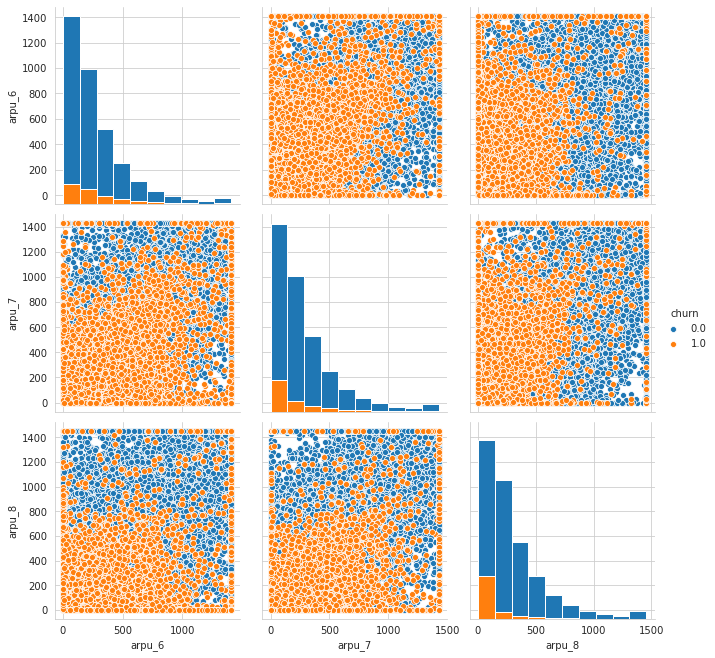

In [36]:
# Objective: Lets check if any of the pair plots can seperate churned and non-churned customers
plt.close();
sns.set_style("whitegrid");
sns.pairplot(arpu, hue="churn", size=3,diag_kind='hist');
plt.show()

<b>Analysis</b>: No clear distinuishing can be made from the above plots. There is a <b>lot of overlapping</b>. From the above pair plots, we can observe that, the churned customers have made a good revenue in one month and not in other month. From the diagonal histogram, we can notice that most of the churned customers have values close to 0.

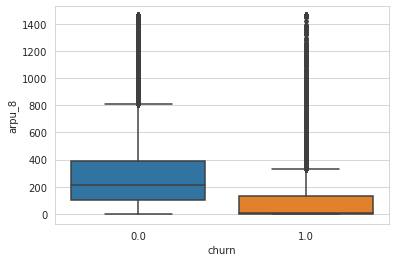

In [37]:
#Objective: To see the spread of values for churned and non churned customers
# Customers churned in 9th month may give less revenue in the 8th month. So lets analyze the box plots with respect to churn
sns.boxplot(x='churn',y='arpu_8', data=arpu)
plt.show()

<b>Analysis</b>: As expected, churned customers have low revenue in 8th month. It can be observed that there is large difference in the mean value of the two churns. Mean of churned customers is <b>close to zero</b>. While the mean revenue of non churned customers is slightly above <b>200.</b>

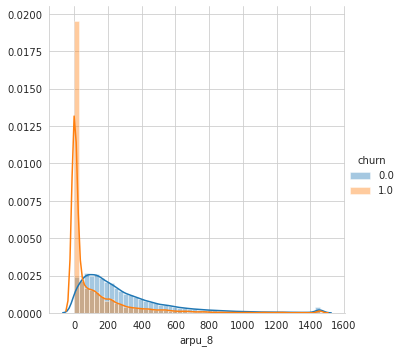

In [38]:
# Objective: To see if the distribution plot can show any seperation at some value
# Since box plots of 8th month revenue provided some useful information, lets see if the distribution plot can distinguish the churn 
sns.FacetGrid(arpu, hue="churn", size=5) \
   .map(sns.distplot, "arpu_8") \
   .add_legend();
plt.show();


<b>Analysis</b>: Through distribution plots and box plots, we can understand that most of the churned customers have produced a <b>low revenue close to 0 </b>in the eighth month. This feature can help slightly in distinguish but still a lot of it is overlapping

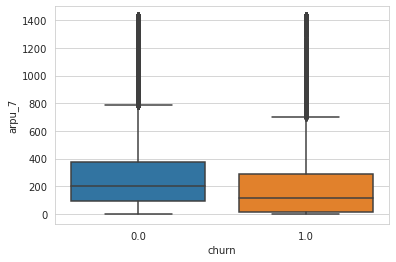

In [39]:
# Objective: Lets check the box plots for 7th month revenue to see if it can distinguish
sns.boxplot(x='churn',y='arpu_7', data=arpu)
plt.show()

<b>Analysis</b>: We <b>can see slight difference in the quantile values</b>. The mean value for churned customers is much higher than the 8th month. The means for churned and non churned customers is close. May be there is much overlapping between the values. Lets confirm it by plotting distribution plots.

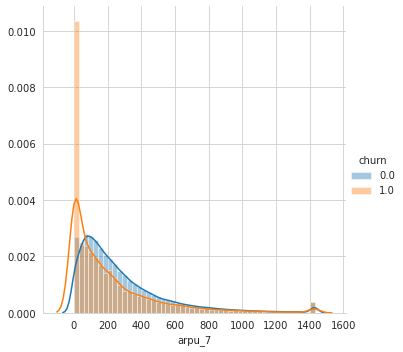

In [40]:
# Objective: To see if the distribution plot can show any seperation at some value
sns.FacetGrid(arpu, hue="churn", size=5) \
   .map(sns.distplot, "arpu_7") \
   .add_legend();
plt.show();


<b>Analysis</b>: As we have expected, there is a lot of overlapping. But the common thing that we can observe is that, many of the churned customers have a value close to 0

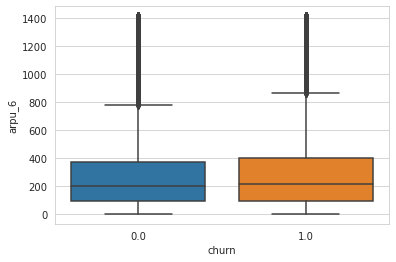

In [41]:
#Objective: To see the spread of values for churned and non churned customers

sns.boxplot(x='churn',y='arpu_6', data=arpu)
plt.show()

<b>Analysis</b>: Similar to the seventh month there seem to be a lot of overlapping. Also the mean value of churned customers and the non churned customers is almost equal. So the 6th month revenue might not be that helpful in distinguishing

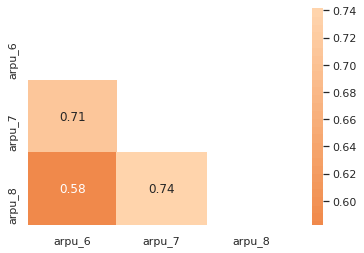

In [42]:
# Now lets check for the correlations among them
sns.set(style="white")

# Compute the correlation matrix
corr = arpu.iloc[:,:-1].corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=np.bool))

# Set up the matplotlib figure
#f, ax = plt.subplots(figsize=(11, 9))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, center=0,annot=True)

<b>Analysis</b>: There is some correlation between arpu_6, arpu_7 and arpu_7,arpu_8. It implies that if there is high revenue in a month, then it is possible that there could be high revenue in the following month also.

## Observations of arpu features

- The histograms from the pair plots say that the revenue produced by the churned customers in the 8th month is mostly close to zero
- The box plots and the distribution plot also indicates the same thing
- Through box plots,we can notice that the spread of values of is distinugishable for 8th month. But is not the case for the other months.
- There is a huge overlap of values for 6,7 months

In [43]:
# Quantile values of onnet and offnet
net.quantile([0.25,0.5,0.75,0.9,1])

,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,churn
0.25,7.3800,6.6600,6.460,34.7300,32.1900,31.630,0.0
0.50,34.3100,32.3300,32.360,96.3100,91.7350,92.140,0.0
0.75,118.7400,115.5950,115.860,231.8600,226.8150,228.260,0.0
0.90,344.1020,348.0350,345.030,477.3250,480.4310,486.310,1.0
1.00,1431.7605,1478.5333,1480.334,1539.5358,1549.3795,1530.398,1.0


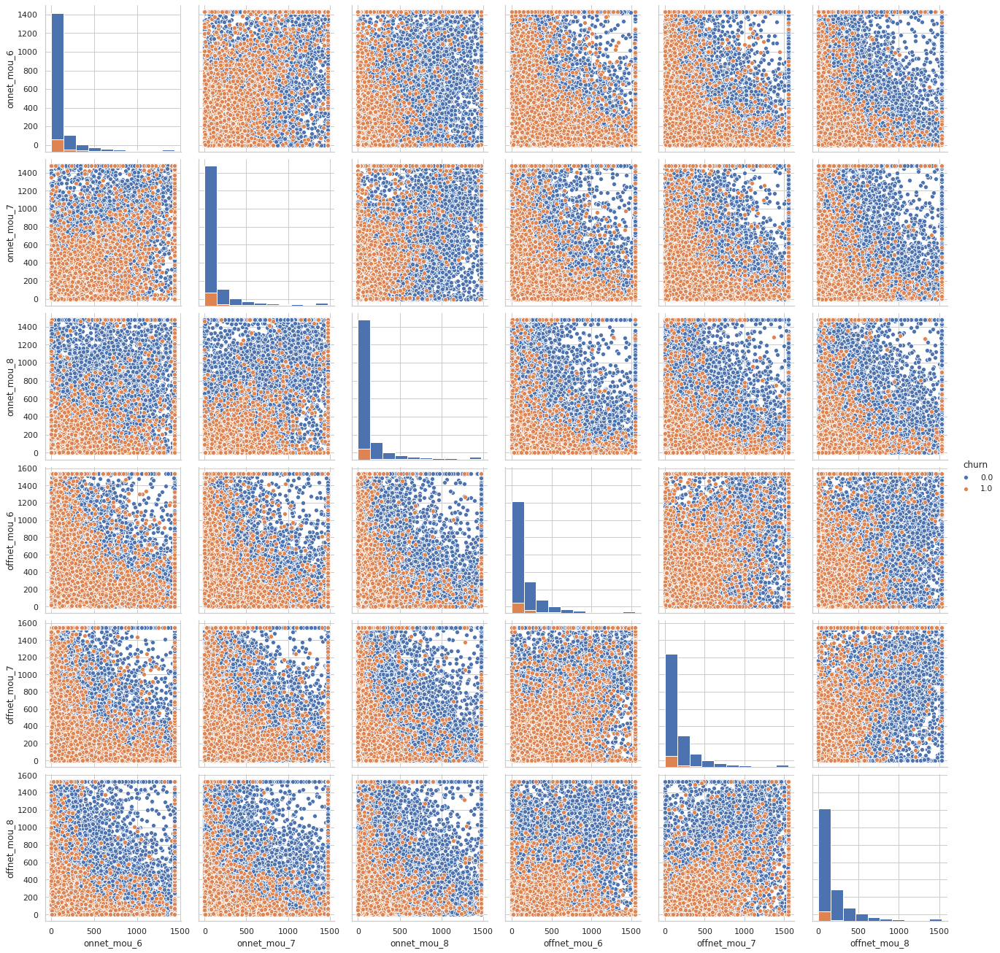

In [50]:
# Objective: Lets check if any of the pair plots can seperate churned and non-churned customers
plt.close();
sns.set_style("whitegrid");
sns.pairplot(net, hue="churn", size=3,diag_kind='hist');
plt.show()

<b>Analysis</b>: Even in these features, no clear seperation can be found. But for most of the churned customers the value in either of the month is nearly 0. The histogram says that for the eighth month, a lot of values are zeros

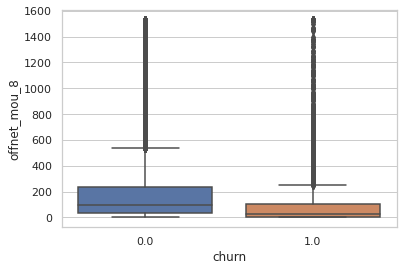

In [51]:
#Objective: To see the spread of values for churned and non churned customers for 8th month
sns.boxplot(x='churn',y='offnet_mou_8', data=net)
plt.show()

<b>Analysis</b>: Similar to arpu features, the 8th month the values of churned customers is close to zero. Their mean is quite less compared to non churned customers.

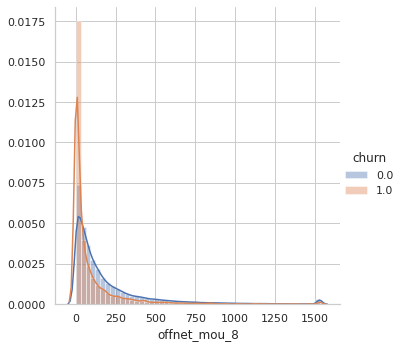

In [52]:
# Objective: To see if the distribution plot can show any seperation at some value
sns.FacetGrid(net, hue="churn", size=5) \
   .map(sns.distplot, "offnet_mou_8") \
   .add_legend();
plt.show();


<b>Analysis</b>: Unlike arpu_8, there is a lot of overlapping for 8th month. But we can see a large number of values close to 0.

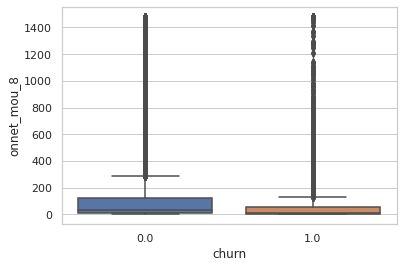

In [53]:
#Objective: To see the spread of values for churned and non churned customers
sns.boxplot(x='churn',y='onnet_mou_8', data=net)
plt.show()

<b>Analysis</b>: The onnet values of 8th month are much less compared to other onnet and offnet values. The 50th percentile value of non churned customers is equal to 75th percentile value of churned customers. There might also be lot of overlapping


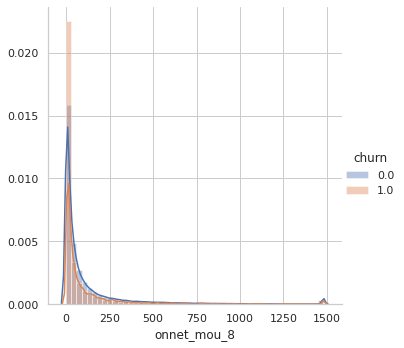

In [54]:
#Lets check if our assumption about overlaping is right
# Objective: To see if the distribution plot can show any seperation at some value

sns.FacetGrid(net, hue="churn", size=5) \
   .map(sns.distplot, "onnet_mou_8") \
   .add_legend();
plt.show();


<b>Analysis</b>: As we expected, there is a lot of overlapping. A peak can be observed close to value of 0, meaning that a lot of values including non churned customers have 0.

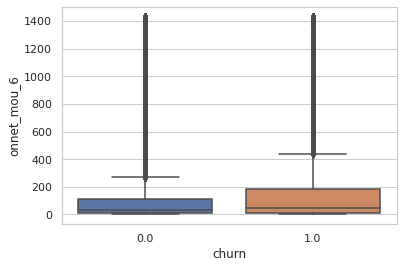

In [55]:
#Objective: To see the spread of values for churned and non churned customers for 6th month
sns.boxplot(x='churn',y='onnet_mou_6', data=net)
plt.show()

<b>Analysis</b>: A clear overlapping among the values can be seen. The mean value is slightly more for churned cuatomers.

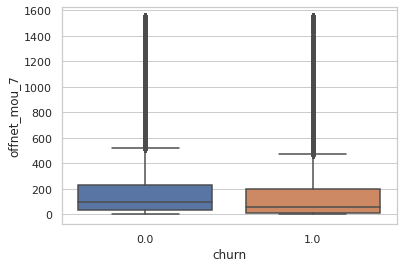

In [56]:
#Objective: To see the spread of values for churned and non churned customers for 7th month
sns.boxplot(x='churn',y='offnet_mou_7', data=net)
plt.show()

<b>Analysis</b>: Like the other features, offnet for 7th month also have a lot of overlapping. The qunatile values are almost equal for both churned and non churned customers

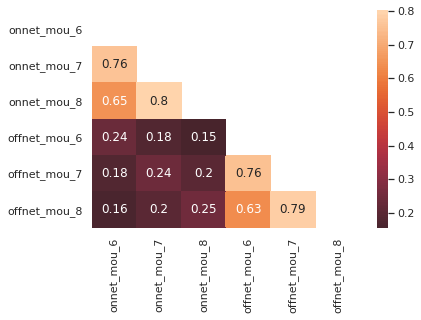

In [57]:
sns.set(style="white")

# Compute the correlation matrix
corr = net.iloc[:,:-1].corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=np.bool))

# Set up the matplotlib figure
#f, ax = plt.subplots(figsize=(11, 9))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, center=0,annot=True)

<b>Analysis</b>: We can see correlation between 7th and 8th month features. Implying that if calls in seventh month are more, then calls in the eighth month will also be high. We have seen similar kind of correlation for arpu also.

## Observations of onnet and offnet features

- The values for churned and non churned customers doesn't vary a lot for any month
- The mean value for churned customers is less in the 8th month for both onnet and offnet but this difference is not so high
- The distribution plots also show a lot of overlapping
- There is some Correlation between 6,7 months and 7,8 months but there is no correlation between onnet and offnet


In [58]:
# Quantile values of outgoing calls
og.quantile([0.25,0.5,0.75,0.9,0.99,1])

,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,churn
0.25,17.110000,17.480000,17.1100,0.000000,0.00000,0.0000,0.000000,0.00,0.00,0.000000,0.000000,0.0000,0.000000,0.0,0.0,0.0
0.50,65.110000,63.685000,63.7300,11.640000,11.09000,10.4100,0.000000,0.00,0.00,0.000000,0.000000,0.0000,0.000000,0.0,0.0,0.0
0.75,168.270000,164.382500,166.1100,144.837500,150.61500,147.9400,0.000000,0.00,0.00,2.430000,3.710000,3.9900,0.000000,0.0,0.0,0.0
0.90,356.908000,348.492000,349.9100,523.839000,551.03600,547.3800,0.000000,0.00,0.00,10.640000,13.231000,13.5900,1.280000,0.0,0.0,1.0
0.99,1163.955823,1140.478144,1127.1688,1861.735857,1912.63442,1930.8748,8.083042,8.48,7.03,51.093042,61.423489,60.6364,6.943042,0.0,0.0,1.0
1.00,1164.105700,1140.630400,1127.1960,1861.776300,1912.68200,1931.1660,8.087800,8.48,7.03,51.097800,61.444900,60.6380,6.947800,0.0,0.0,1.0


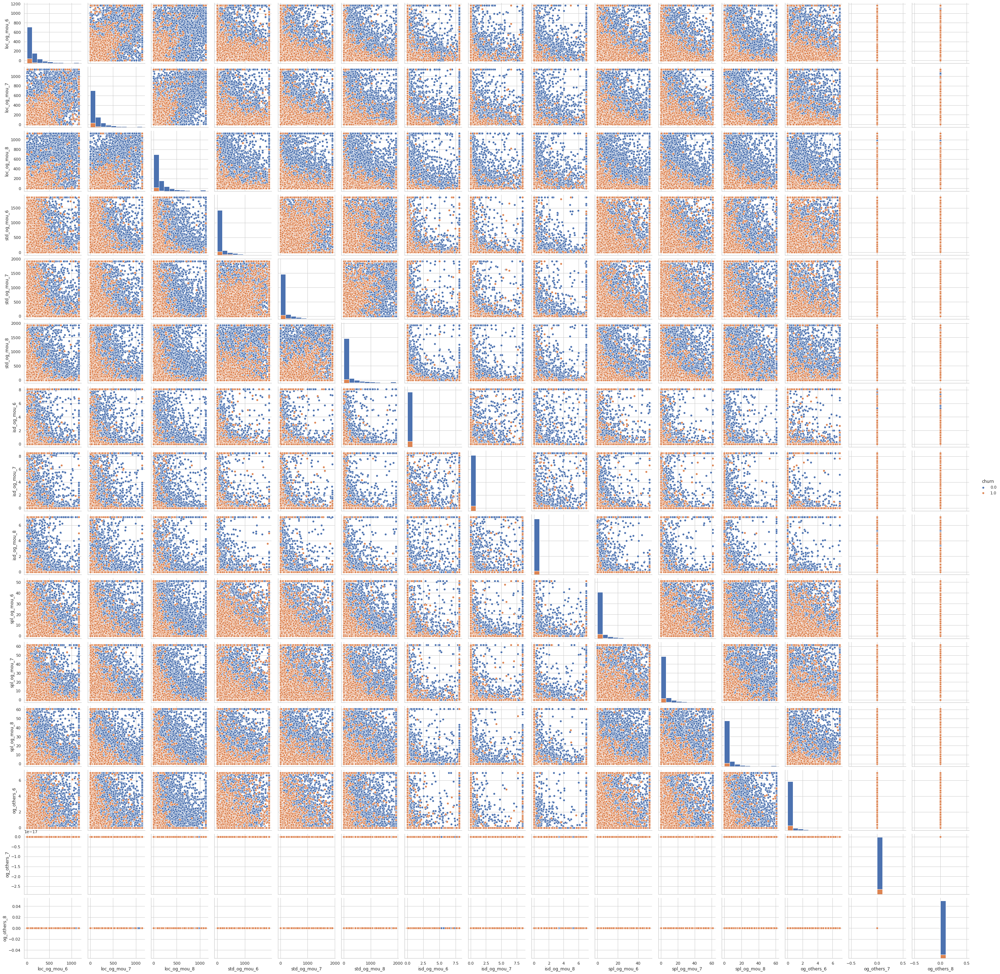

In [59]:
# Objective: Lets check if any of the pair plots can seperate churned and non-churned customers
plt.close();
sns.set_style("whitegrid");
sns.pairplot(og, hue="churn",diag_kind='hist');
plt.show()

Since the plots are not so clear, lets split the columns that we need and plot them seperately

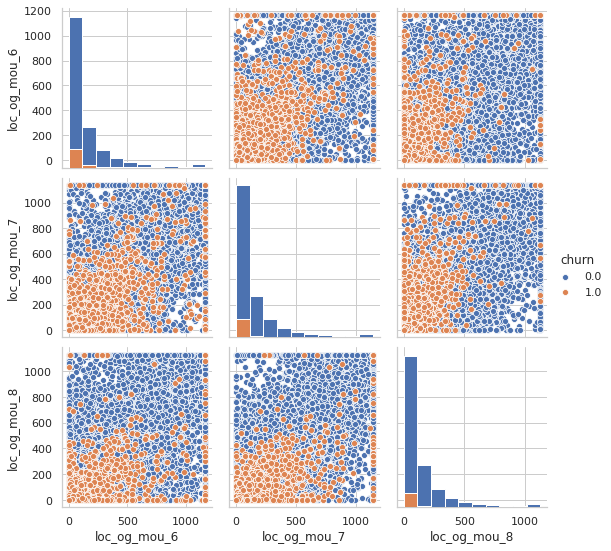

In [61]:
# Objective: To check if any of the pair plot related to local outgoing calls can seperate churned customers
loc_og=og.iloc[:,[0,1,2,-1]]  # Splitting the local outgoing calls
plt.close();
sns.set_style("whitegrid");
sns.pairplot(loc_og, hue="churn",diag_kind='hist');
plt.show()

<b>Analysis</b>: The plots with data of 8th month seem to be a little distinguishable. Lets try these pair plots along with std calls.

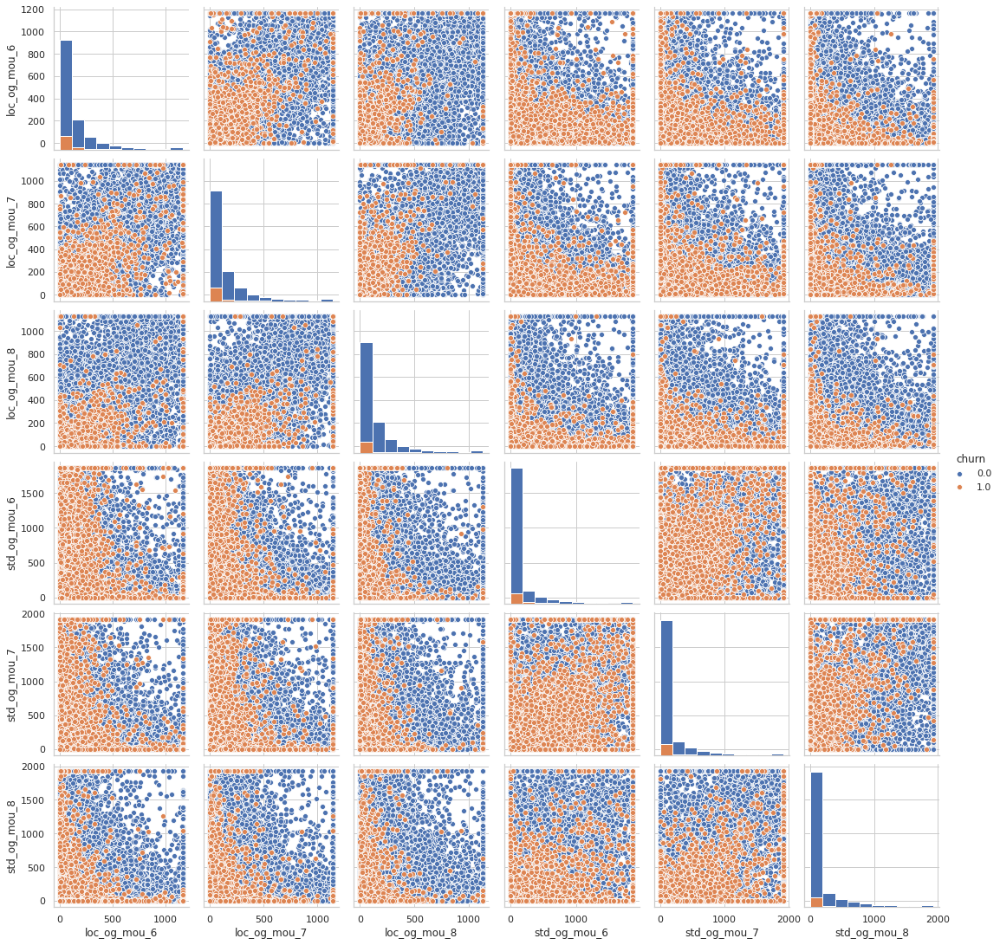

In [62]:
# Objective: Lets check if any of the local vs std outgoing calls plot can seperate churned customers
# Pair plots for local and std outgoing calls.
loc_std_og=og.iloc[:,[0,1,2,3,4,5,-1]]
plt.close();
sns.set_style("whitegrid");
sns.pairplot(loc_std_og, hue="churn",diag_kind='hist');
plt.show()

<b>Analysis</b>: Local vs std plots looks much more distinguishable. Especially the ones which include local calls of 8th month.

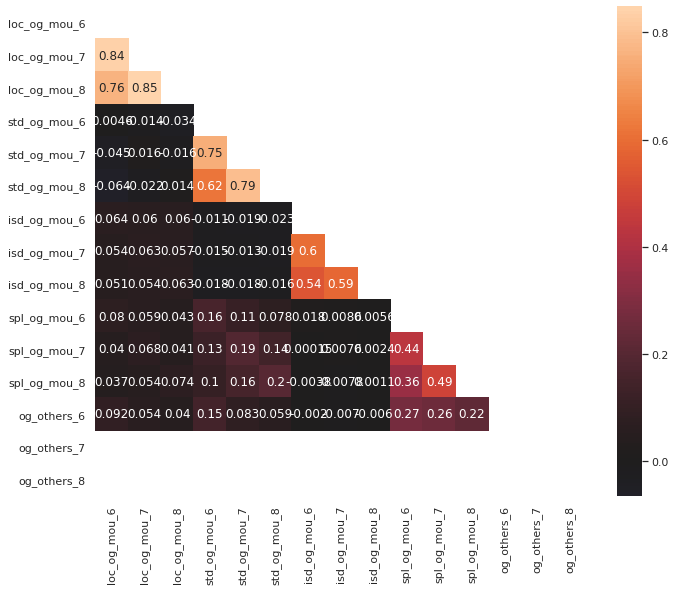

In [63]:
# Objective: To check the correlation among the outgoing call features
sns.set(style="white")

# Compute the correlation matrix
corr = og.iloc[:,:-1].corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=np.bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, center=0,annot=True)

<b>Analysis</b>: There is some correlation between loc_og_mou_6, loc_og_mou_7 and between loc_og_mou_7, loc_og_mou_8. Implying that if a customer has made more calls in one month, there is a high chance of making more calls in the following month also

## Observations of outgoing mou features

- Most of the outgoing calls are local calls. STD and ISD calls are very less
- Pair plots containing 8th month local calls could slightly distinguish the churn
- As observed in the earlier features, there is correlation between 6,7 months and 7,8 months.
- There is no correlation among local, std and isd


In [64]:
# Quantile values of recharge
total_rech.quantile([0.5,0.75,0.9,0.99,1])

,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,churn
0.50,6.0,6.0,5.0,230.0000,220.0,225.0,0.0
0.75,9.0,10.0,9.0,437.5000,428.0,434.5,0.0
0.90,15.0,16.0,15.0,732.0000,731.0,736.0,1.0
0.99,35.0,35.0,35.0,1683.0004,1728.0,1721.0,1.0
1.00,35.0,35.0,35.0,1683.0200,1728.0,1721.0,1.0


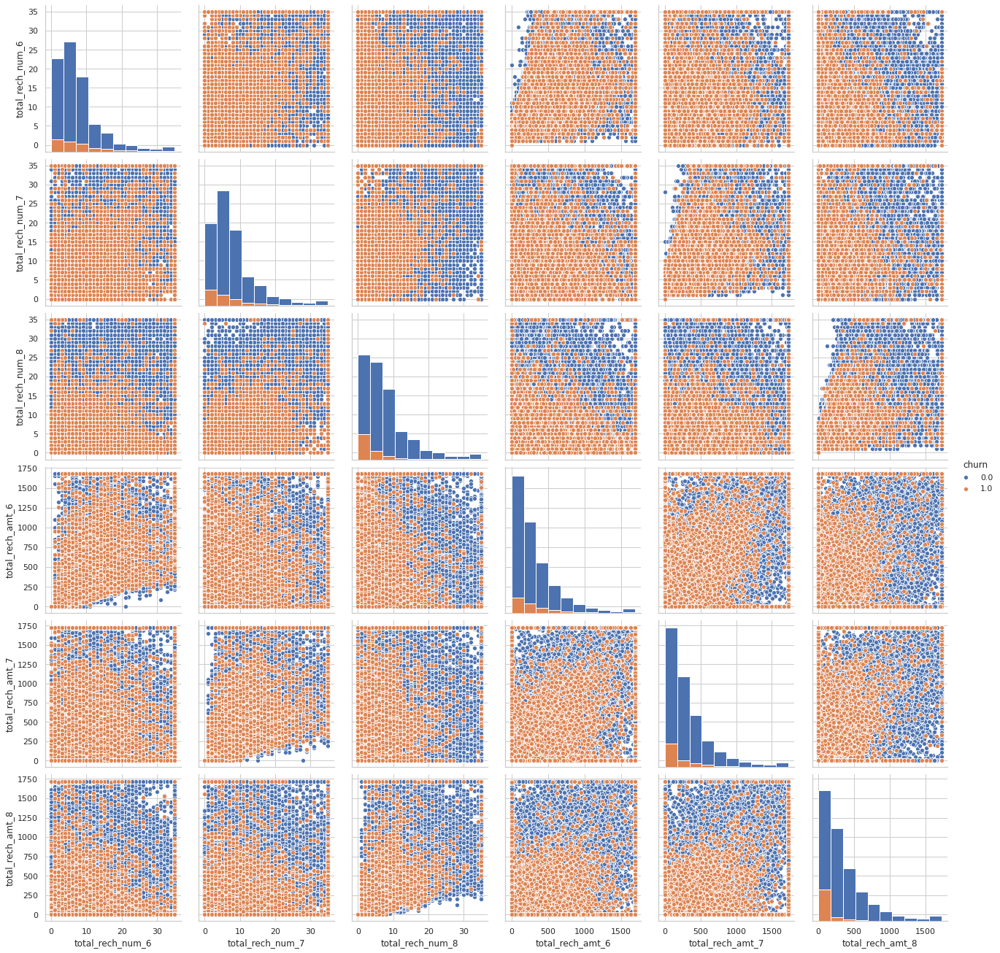

In [65]:
# Objective: Lets check if any of the pair plots can seperate churned and non-churned customers
plt.close();
sns.set_style("whitegrid");
sns.pairplot(total_rech, hue="churn", size=3,diag_kind='hist');
plt.show()

<b>Analysis</b>: High overlap can be observed. The churned customers have made less recharge in the 8th month. Over 250 churned customers have recharge amounts close to 0 and also number of recharges made for 8th month are also low.

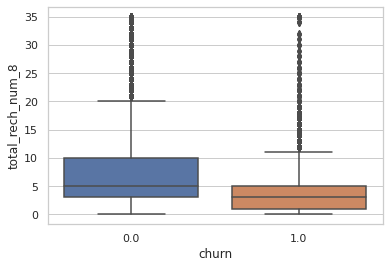

In [66]:
# Lets dig deep into total number of recharges  for 8th month
#Objective: To see the spread of values for churned and non churned customers

sns.boxplot(x='churn',y='total_rech_num_8', data=total_rech)
plt.show()

<b>Analysis</b>: There is not huge differenece in the number of recharges for churned and non churned customers. Churned customers have made 2 recharges on an average while non churned customers have made 4

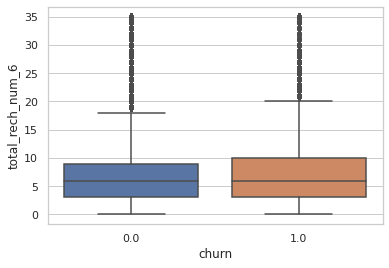

In [67]:
# Box plots for number of recharges in 6th month
#Objective: To see the spread of values for churned and non churned customers

sns.boxplot(x='churn',y='total_rech_num_6', data=total_rech)
plt.show()

<b>Analysis</b>: Not much could be found. Churned customers have slightly made more number of recharges in the 6th month. Lot of overlapping

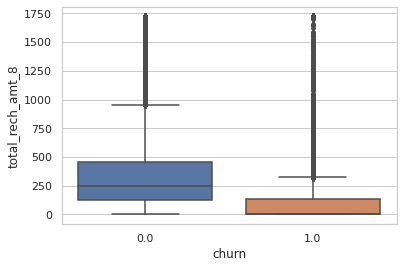

In [68]:
#Objective: To see the spread of values for churned and non churned customers

sns.boxplot(x='churn',y='total_rech_amt_8', data=total_rech)
plt.show()

<b>Analysis</b>: As we could see, there is a lot of difference in the recharges made by churned customers and non churned customers. Most of the churned customers have done a low recharge in the 8th month. 

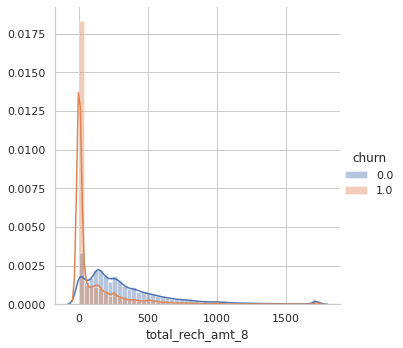

In [69]:
# Lets plot the distribution plot to see in depth
# Objective: To see if the distribution plot can show any seperation at some value

sns.FacetGrid(total_rech, hue="churn", size=5) \
   .map(sns.distplot, "total_rech_amt_8") \
   .add_legend();
plt.show();


<b>Analysis</b>: There is a peak at the value close to zero meaning that a lot of churned customers made no recharge in this month. This is what that we have observed from the pair plot histogram also

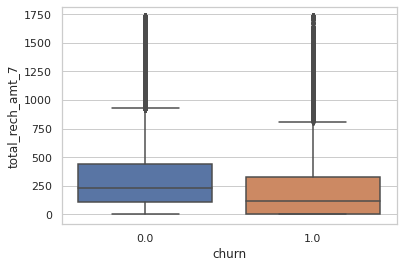

In [70]:
# Lets see if there is some similar trend for the 7th month 
#Objective: To see the spread of values for churned and non churned customers

sns.boxplot(x='churn',y='total_rech_amt_7', data=total_rech)
plt.show()

<b>Analysis</b>: The values do not differ as much they have in 8th month, but there is some noticable difference in the mean value of recharge amounts. The avg recharge for non churned customers is around 100 while it is around 40 for churned customers

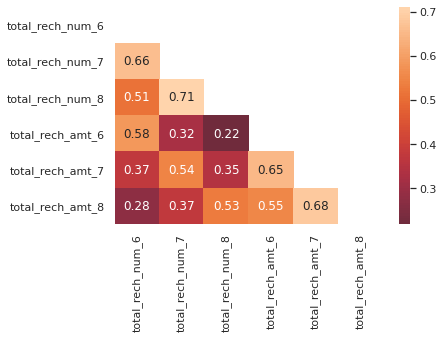

In [71]:
sns.set(style="white")

# Compute the correlation matrix
corr = total_rech.iloc[:,:-1].corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=np.bool))

# Set up the matplotlib figure
#f, ax = plt.subplots(figsize=(11, 9))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, center=0,annot=True)

<b>Analysis</b>: We can see correlation between 6,7 and 7,8 months. This is similar to what we have seen for earlier features.

## Observations of total no. of recharges and amount of recharge features

- For any month, there is not much difference between number of recharges made for churned and non churned customers
- But some difference can be noticed in amount of recharges. This difference is highest in the 8th month.
- The churned customers have made a very low recharge in the 8th month
- Total number of recharges feature may not be that useful



In [72]:
# Quantile values for total outgoing mou
total_og.quantile([0.25,0.5,0.75,0.9,0.99,1])

,total_og_mou_6,total_og_mou_7,total_og_mou_8,churn
0.25,44.740000,43.0100,38.58000,0.0
0.50,145.140000,141.5300,138.61000,0.0
0.75,372.860000,378.5700,369.90000,0.0
0.90,779.036000,804.4940,791.49400,1.0
0.99,2207.841068,2270.1102,2249.69012,1.0
1.00,2207.893400,2270.1200,2249.69600,1.0


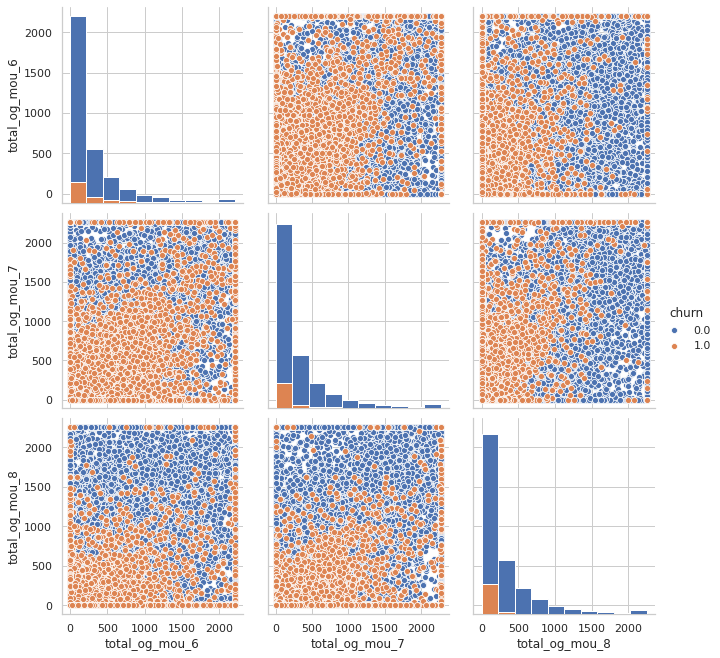

In [73]:
# Objective: Lets check if any of the pair plots can seperate churned and non-churned customers
plt.close();
sns.set_style("whitegrid");
sns.pairplot(total_og, hue="churn", size=3,diag_kind='hist');
plt.show()

<b>Analysis</b>: These plots are similar to the pair plots of the other features with a lot of overlapping

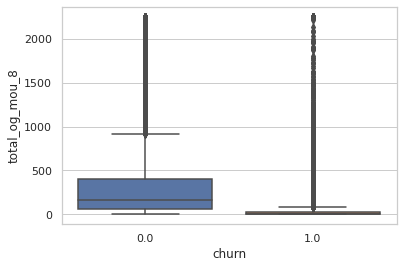

In [74]:
#Objective: To see the spread of values for churned and non churned customers
sns.boxplot(x='churn',y='total_og_mou_8', data=total_og)
plt.show()

<b>Analysis</b>: The mean value is 0 for churned customers while it is around 100 for non churned customers. There seem to be a lot of outliers for these.

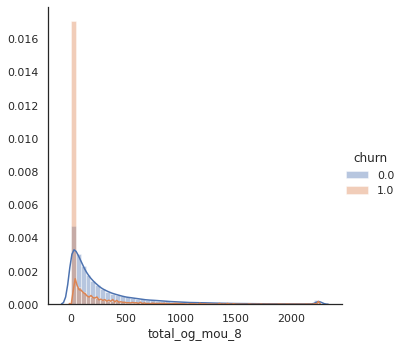

In [76]:
# Lets plot the distribution plot to see in depth
# Objective: To see if the distribution plot can show any seperation at some value

sns.FacetGrid(total_og, hue="churn", size=5) \
   .map(sns.distplot, "total_og_mou_8") \
   .add_legend();
plt.show();


<b>Analysis</b>: The churned customers have made very less calls compared to the non churned customers in the 8th month

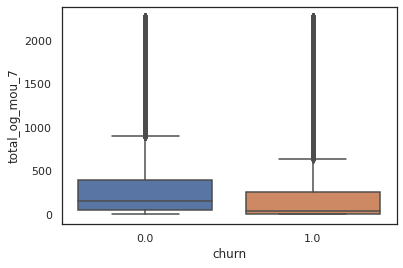

In [77]:
#Objective: To see the spread of values for churned and non churned customers
sns.boxplot(x='churn',y='total_og_mou_7', data=total_og)
plt.show()

<b>Analysis</b>: The outgoing calls are signifiacantly more in the 7th month than 8th for the churned customers. There seem to be a lot of overlapping

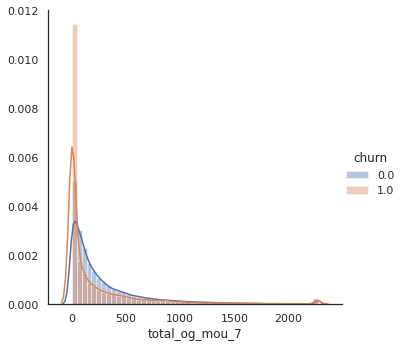

In [78]:
# Lets plot the distribution plot to see in depth
# Objective: To see if the distribution plot can show any seperation at some value

sns.FacetGrid(total_og, hue="churn", size=5) \
   .map(sns.distplot, "total_og_mou_7") \
   .add_legend();
plt.show();

<b>Analysis</b>: Lot of overlapping can be seen. Many of the churned customers have values close to 0

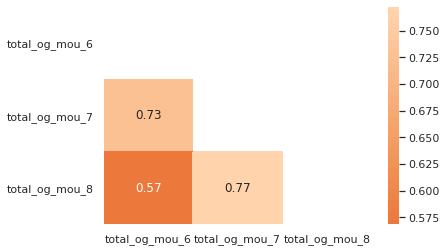

In [75]:
sns.set(style="white")

# Compute the correlation matrix
corr = total_og.iloc[:,:-1].corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=np.bool))

# Set up the matplotlib figure
#f, ax = plt.subplots(figsize=(11, 9))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, center=0,annot=True)

<b>Analysis</b>: No high correlation is observed

## Observations of total outgoing mou features

- There are many churned customers whose values are close to zero in the 8th month
- The churned customers have made very few outgoing calls when compared non churned customers
- This low value for chured customers is only observed in the 8th month and not in any other month
- This means, a sudden drop in outgoing calls in the 8th month implies a high chance for the churn

In [81]:
# Average internet revenue
arpu_net.quantile([0.25,0.5,0.75,0.9])

,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,churn
0.25,0.00,0.00,0.000,0.00,0.00,0.00,0.0
0.50,0.48,0.42,0.880,10.83,8.81,9.27,0.0
0.75,122.07,119.56,122.070,122.07,122.07,122.07,0.0
0.90,247.17,244.14,250.682,224.00,221.97,224.00,1.0


<b>Analysis</b>: We can see that most of the users do not use internet much. And there are more users for 2g than 3g

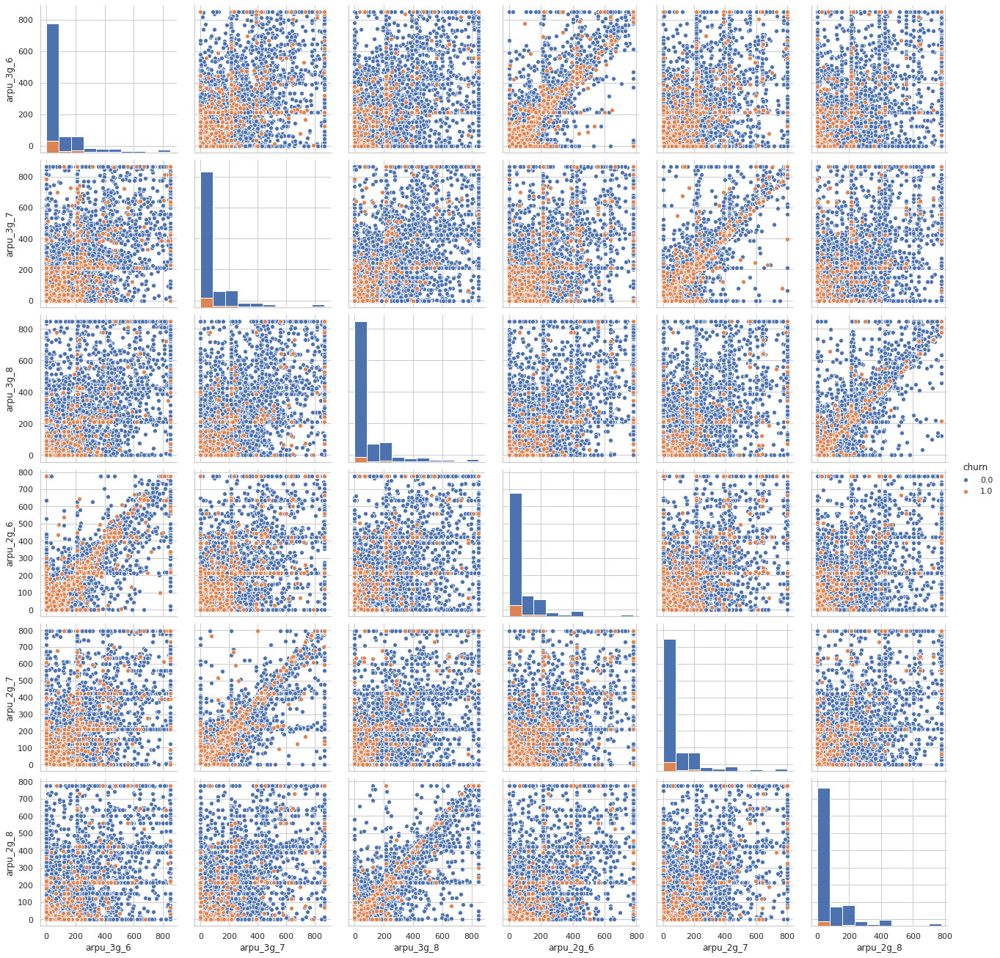

In [82]:
# Objective: Lets check if any of the pair plots can seperate churned and non-churned customers
plt.close();
sns.set_style("whitegrid");
sns.pairplot(arpu_net, hue="churn", size=3,diag_kind='hist');
plt.show()

<b>Analysis</b>: As we have observed in the quantile values, the histograms also say that the users are less.

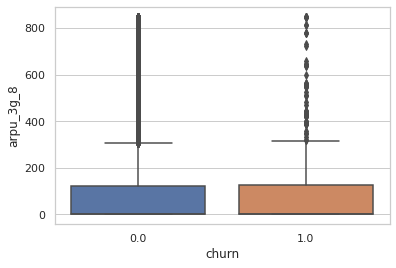

In [83]:
# Lets see what the box plots can tell
sns.boxplot(x='churn',y='arpu_3g_8', data=arpu_net)
plt.show()

<b>Analysis</b>: The values look similar for both churned and non churned customers. Their plots may have high overlapping.

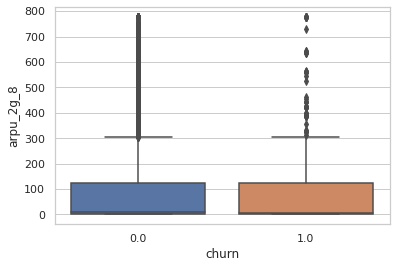

In [84]:
# Lets check if it same with 2g data
sns.boxplot(x='churn',y='arpu_2g_8', data=arpu_net)
plt.show()

<b>Analysis</b>: Interstingly, churned customers produce more revenue though net for the eighth month than non-churned customers. But here also it looks like a lot of overlapping

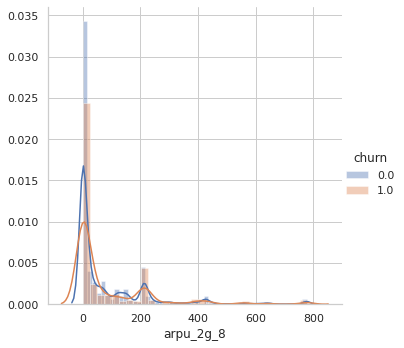

In [85]:
# Lets check the distribution plots for more clarification
# Objective: To see if the distribution plot can show any seperation at some value

sns.FacetGrid(arpu_net, hue="churn", size=5) \
   .map(sns.distplot, "arpu_2g_8") \
   .add_legend();
plt.show();


<b>Analysis</b>: The distribution plot also indicates that the mean of churned customers is higher than non churned customers

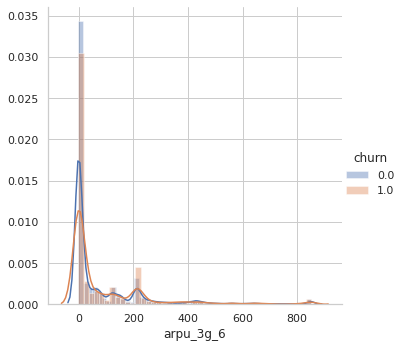

In [86]:
# lets see if the distribution is same for all the other months.
# Objective: To see if the distribution plot can show any seperation at some value

sns.FacetGrid(arpu_net, hue="churn", size=5) \
   .map(sns.distplot, "arpu_3g_6") \
   .add_legend();
plt.show();

<b>Analysis</b>: The values are close to 0 for both churned and non churned customers. The 3g data usage is very low for the 6th month

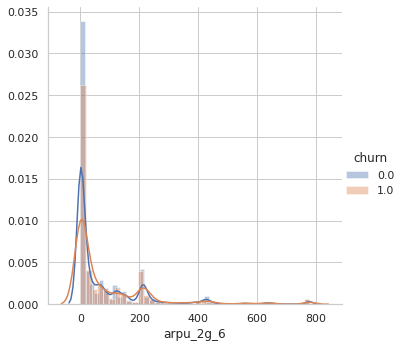

In [87]:
# Distribution plot for 2g data in 6th month
# Objective: To see if the distribution plot can show any seperation at some value

sns.FacetGrid(arpu_net, hue="churn", size=5) \
   .map(sns.distplot, "arpu_2g_6") \
   .add_legend();
plt.show();


<b>Analysis</b>: Revenue produced thorugh internet data is identical for both churned and non churned customers

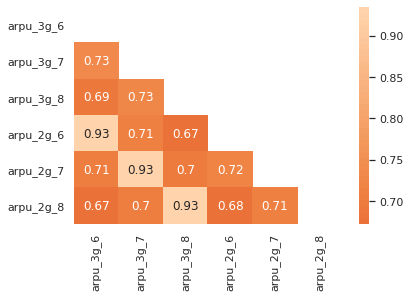

In [88]:
sns.set(style="white")

# Compute the correlation matrix
corr = arpu_net.iloc[:,:-1].corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=np.bool))

# Set up the matplotlib figure
#f, ax = plt.subplots(figsize=(11, 9))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, center=0,annot=True)

<b>Analysis</b>: No high correlation is observed among the data usage

## Observations of avg revenue from internet feature

- The internet users are very low when compared to the call users
- Most of the users tend to use 2g internet than 3g
- We can see very high correlation between 2g and 3g data
- The internet usage is almost same for both churned and non churned customers. So this feature may not be that useful


In [89]:
# Quantile values for incoming calls
ic_t.iloc[:,:-1].quantile([0.5,0.75,0.9,1])

,loc_ic_mou_t_6,loc_ic_mou_t_7,loc_ic_mou_t_8,std_ic_mou_t_6,std_ic_mou_t_7,std_ic_mou_t_8
0.50,92.1450,92.5400,93.810,5.8900,5.9500,5.880
0.75,208.0650,205.8200,207.270,26.9300,28.3000,27.690
0.90,393.6000,390.7120,391.010,75.7190,78.1710,76.770
1.00,1163.9965,1179.3379,1147.634,401.0434,419.3069,413.134


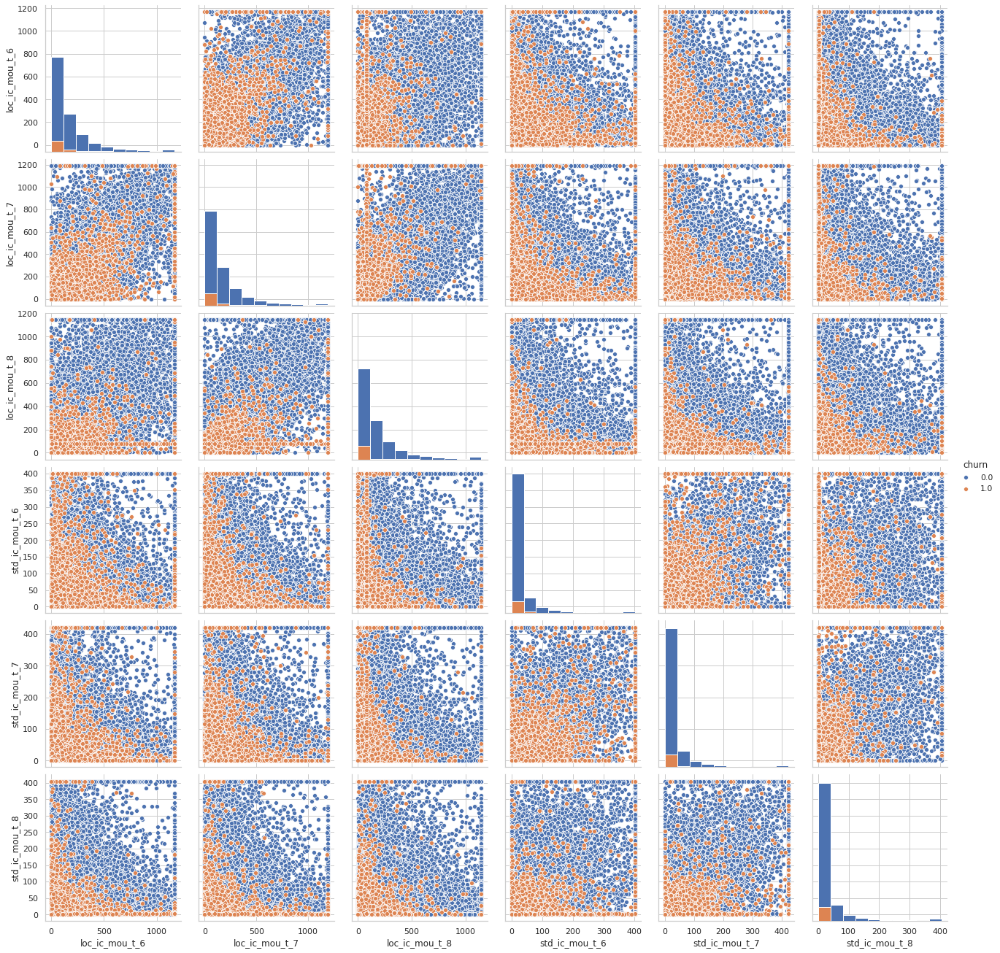

In [109]:
# Objective: Lets check if any of the pair plots can seperate churned and non-churned customers
plt.close();
sns.set_style("whitegrid");
sns.pairplot(ic_t, hue="churn", size=3,diag_kind='hist');
plt.show()

<b>Analysis</b>: The histogram shows that the std incoming calls are very less compared to the local calls. There seem to be some distinguish between the pair plots.


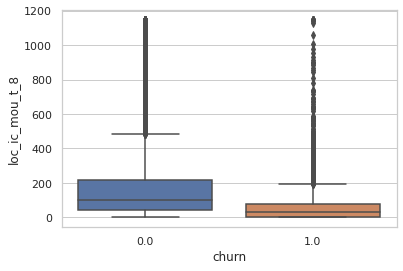

In [110]:
#Objective: To see the spread of values for churned and non churned customers
sns.boxplot(x='churn',y='loc_ic_mou_t_8',data=ic_t)

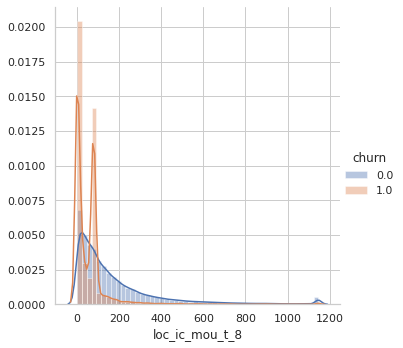

In [111]:
# Lets see the distribution plot for more clarity
# Objective: To see if the distribution plot can show any seperation at some value

sns.FacetGrid(ic_t, hue="churn", size=5) \
   .map(sns.distplot, "loc_ic_mou_t_8") \
   .add_legend();
plt.show();


<b>Analysis</b>: Here two peaks can be seen for churned customers, one at 0 and other at 100. Most of the values lie below 100 for churned customers


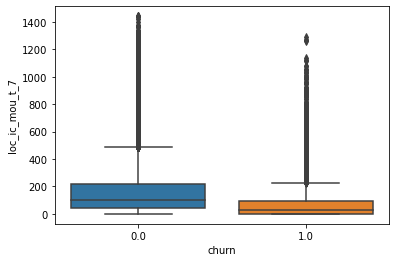

In [56]:
#Objective: To see the spread of values for churned and non churned customers
sns.boxplot(x='churn',y='loc_ic_mou_t_7',data=ic_t)

<b>Analysis</b>: It looks similar to 8th month plot with some slight difference in values

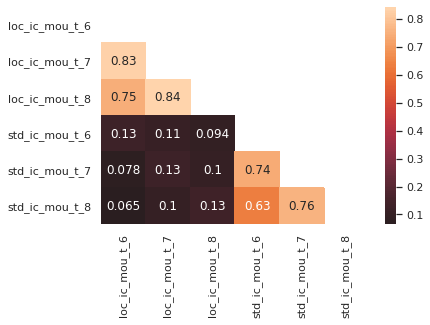

In [112]:
# Lets check the correlations
sns.set(style="white")

# Compute the correlation matrix
corr = ic_t.iloc[:,:-1].corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=np.bool))

# Set up the matplotlib figure
#f, ax = plt.subplots(figsize=(11, 9))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, center=0,annot=True)

<b>Analysis</b>: There are some high correlations but it is same as the outgoing features

## Observations from incoming call features

- The incoming calls for churned and non churned customers follow similar pattern for all the months.
- We cannot see any decrease for 8th month when compared to the other months.
- Pair plots with std vs local calls look to distinguish the churned customers better
- As observed in the other call features, there is correlation between 6,7th and 7,8th months

## Adding extra features

### Fall feature.
This fall feature is calculated for the most important features like average revenue per user and total outgoing mou. In this we calculate the average of 6th and 7th month, subtracted it from the 8th month and divide it by average of 6th and 7th month. Since most of the churned customers have low values for 8th month, this value will be negative for them and positive for non churned customers

In [31]:
# Function to get the arpu fall rate
def arpu_fall(df1):
    avg=(df1['arpu_6']+df1['arpu_7'])/2
    val=round((df1['arpu_8']-avg)/avg,2)*100      
    if (avg!=0 ):
        return val
    else:
        return avg

In [32]:
df['fall_arpu']=df.apply(arpu_fall,axis=1) # Applying function to get fall_arpu
df['fall_arpu'].head(10)

0      4.0
1     38.0
2     18.0
3    115.0
4    -17.0
5     53.0
6    -18.0
7     20.0
8    -68.0
9     -7.0
Name: fall_arpu, dtype: float64

In [33]:
df.loc[:,['churn','fall_arpu']].head()

,churn,fall_arpu
0,1.0,4.0
1,0.0,38.0
2,0.0,18.0
3,0.0,115.0
4,0.0,-17.0


In [34]:
# Function to get the outgoing fall rate
def og_fall(df1):
    avg=(df1['total_og_mou_6']+df1['total_og_mou_7'])/2
    val=round((df1['total_og_mou_8']-avg)/avg,2)*100      
    if (avg!=0 ):
        return val
    else:
        return avg

In [35]:
df['fall_og']=df.apply(og_fall,axis=1) # Applying function
df['fall_og'].head()

0      0.0
1    186.0
2      0.0
3     96.0
4     13.0
Name: fall_og, dtype: float64

In [36]:
df.head()

,mobile_number,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,...,std_og_mou_t_7,std_og_mou_t_8,loc_ic_mou_t_6,loc_ic_mou_t_7,loc_ic_mou_t_8,std_ic_mou_t_6,std_ic_mou_t_7,std_ic_mou_t_8,fall_arpu,fall_og
0,7.000843e+09,197.385,214.816,213.803,NaN,NaN,0.00,NaN,NaN,0.00,...,NaN,0.00,NaN,NaN,5.44,NaN,NaN,0.00,4.0,0.0
1,7.001866e+09,34.047,355.074,268.321,24.11,78.68,7.68,15.74,99.84,304.76,...,4.57,0.13,19.09,104.22,408.42,5.90,0.00,14.84,38.0,186.0
2,7.001626e+09,167.690,189.058,210.226,11.54,55.24,37.26,143.33,220.59,208.36,...,108.66,120.94,229.55,208.84,155.98,139.32,306.64,239.01,18.0,0.0
3,7.001204e+09,221.338,251.102,508.054,99.91,54.39,310.98,123.31,109.01,71.68,...,16.62,296.11,233.47,111.58,48.16,45.99,105.00,4.94,115.0,96.0
4,7.000142e+09,261.636,309.876,238.174,50.31,149.44,83.89,76.96,91.88,124.26,...,0.00,0.00,214.02,198.03,337.94,1.93,0.25,0.86,-17.0,13.0


In [37]:
print(df.shape)
df[df['churn']==1].head()

(99999, 128)


,mobile_number,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,...,std_og_mou_t_7,std_og_mou_t_8,loc_ic_mou_t_6,loc_ic_mou_t_7,loc_ic_mou_t_8,std_ic_mou_t_6,std_ic_mou_t_7,std_ic_mou_t_8,fall_arpu,fall_og
0,7.000843e+09,197.385,214.816,213.80300,NaN,NaN,0.00,NaN,NaN,0.00,...,NaN,0.00,NaN,NaN,5.44,NaN,NaN,0.00,4.0,0.0
7,7.000702e+09,1069.180,1349.850,1455.53996,57.84,54.68,52.29,453.43,567.16,325.91,...,75.13,77.83,427.86,355.21,188.03,180.52,173.06,193.93,20.0,-36.0
29,7.000040e+09,147.460,22.460,0.00000,19.38,14.33,0.00,145.84,29.81,0.00,...,43.19,0.00,3.64,0.00,0.78,21.89,0.41,0.00,-100.0,-99.0
32,7.000383e+09,60.651,22.064,52.38000,0.00,0.00,39.29,10.90,0.00,0.20,...,0.00,0.00,14.44,32.10,6.95,0.00,0.00,0.00,27.0,876.0
35,7.002109e+09,596.376,13.448,0.00000,10.51,NaN,NaN,199.74,NaN,NaN,...,NaN,NaN,0.43,NaN,NaN,7.96,NaN,NaN,-100.0,-100.0


## Filling the missing numerical columns

To handle the missing values, we use the following strategy:<br>
- for features with missing values <5% drop those rows,

- For features with missing values >85%, drop those columns.

- For features with 5-25% missing values, you can impute the missing values using median or mode or appropriate methods.

- Now for features with missing values between 25%-85-90%, we use model based imputation technique

In [38]:
# List all the column names with null values and their percent
count=0
null_col=[]
percent_null=[]
for i in df.columns:
    value=df[i].isnull().sum()
    null_percent=round((value/len(df[i].index))*100,2)
    if(value>0):
        null_col.append(i)
        percent_null.append(null_percent)
        count+=1
print('---------------------------------------------------')
print('Number of columns with null values ',count)

---------------------------------------------------
Number of columns with null values  75


In [39]:
df_copy=df.copy()
df_copy.shape

(99999, 128)

In [40]:
# Before filling these missing values, lets analyze the standard deviation of all the columns
std=df_copy.std()
std.head(10)

mobile_number    695261.810490
arpu_6              268.727549
arpu_7              270.990963
arpu_8              275.651867
onnet_mou_6         240.333553
onnet_mou_7         248.025504
onnet_mou_8         246.521364
offnet_mou_6        265.731432
offnet_mou_7        269.207244
offnet_mou_8        266.880464
dtype: float64

In [41]:
std.tail()

std_ic_mou_t_6        61.099163
std_ic_mou_t_7        63.597517
std_ic_mou_t_8        62.592113
fall_arpu         112991.288430
fall_og            18516.659574
dtype: float64

In [39]:
#Drop the rows for features with missing value <5%
rem_col=[]
for i in range(len(percent_null)):
    if(percent_null[i]<5):
        rem_col.append(null_col[i])
        #df[null_col[i]].dropna(inplace=True)
        #print(dfnull_col[i],perecent_null[i] )
df.dropna(subset=rem_col,inplace=True)

In [40]:
df.head()

,mobile_number,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,...,std_og_mou_t_7,std_og_mou_t_8,loc_ic_mou_t_6,loc_ic_mou_t_7,loc_ic_mou_t_8,std_ic_mou_t_6,std_ic_mou_t_7,std_ic_mou_t_8,fall_arpu,fall_og
1,7.001866e+09,34.047,355.074,268.321,24.11,78.68,7.68,15.74,99.84,304.76,...,4.57,0.13,19.09,104.22,408.42,5.90,0.00,14.84,38.0,186.0
2,7.001626e+09,167.690,189.058,210.226,11.54,55.24,37.26,143.33,220.59,208.36,...,108.66,120.94,229.55,208.84,155.98,139.32,306.64,239.01,18.0,0.0
3,7.001204e+09,221.338,251.102,508.054,99.91,54.39,310.98,123.31,109.01,71.68,...,16.62,296.11,233.47,111.58,48.16,45.99,105.00,4.94,115.0,96.0
4,7.000142e+09,261.636,309.876,238.174,50.31,149.44,83.89,76.96,91.88,124.26,...,0.00,0.00,214.02,198.03,337.94,1.93,0.25,0.86,-17.0,13.0
5,7.000286e+09,50.258,58.810,83.386,50.16,43.63,85.48,19.28,13.44,14.46,...,4.61,2.08,77.92,87.47,118.72,77.03,71.06,37.93,53.0,58.0


In [41]:
# Removing columns with >85% null values in columns
for i in range(len(percent_null)):
    if(percent_null[i]>85):
        print(null_col[i],percent_null[i] )

There are no columns with null values greater than 85%

In [42]:
# Columns with 5-25% null values
median_fill=[]
for i in range(len(percent_null)):
    if(percent_null[i]>=5 and percent_null[i]<=20):
        median_fill.append(null_col[i])
print(median_fill)        

['onnet_mou_8', 'offnet_mou_8', 'roam_ic_mou_8', 'roam_og_mou_8', 'loc_og_mou_8', 'std_og_mou_8', 'isd_og_mou_8', 'spl_og_mou_8', 'og_others_8', 'loc_ic_mou_8', 'std_ic_mou_8', 'spl_ic_mou_8', 'isd_ic_mou_8', 'ic_others_8', 'loc_og_mou_t_8', 'std_og_mou_t_8', 'loc_ic_mou_t_8', 'std_ic_mou_t_8']


In [43]:
# Imputing these column with median values
#med_val=[]
for i in median_fill:
    median=df[i].median()
    #med_val.append(median)
    df[i].fillna(median,inplace=True)

In [44]:
missing_col=[]
for i in df.columns:
    if(df[i].isnull().any()>0):
        missing_col.append(i)

In [45]:
missing_col

['total_rech_data_6',
 'total_rech_data_7',
 'total_rech_data_8',
 'max_rech_data_6',
 'max_rech_data_7',
 'max_rech_data_8',
 'count_rech_2g_6',
 'count_rech_2g_7',
 'count_rech_2g_8',
 'count_rech_3g_6',
 'count_rech_3g_7',
 'count_rech_3g_8',
 'av_rech_amt_data_6',
 'av_rech_amt_data_7',
 'av_rech_amt_data_8',
 'arpu_3g_6',
 'arpu_3g_7',
 'arpu_3g_8',
 'arpu_2g_6',
 'arpu_2g_7',
 'arpu_2g_8']

In [46]:
temp_df=df.drop(columns=missing_col) 
c=['churn','mobile_number']
temp_df.drop(columns=c,inplace=True) 
for i in missing_col:
    x_train=temp_df[df[i].notnull()] 
    temp=df[i].notnull()
    y_train=df.loc[temp,i]
    x_test=temp_df[df[i].isnull()]
    temp_t=df[i].isnull()
    y_test=df.loc[temp_t,i]
    
    model=LinearRegression()
    model.fit(X=x_train, y=y_train)
    #filename = 'model1_'+str(i)
    #pickle.dump(model, open(filename, 'wb'))
    
    l=model.predict(x_test)
    l=list(l)
    for j in range(99999):
        try:
            if(np.isnan(df[i][j])):
                df[i][j]=l[0]
                l.pop(0)
        except KeyError:
            pass

In [50]:
# Calculating the standard deviation after imputing
std_new=df.std()
std_new.head()

mobile_number    691873.393335
arpu_6              268.942486
arpu_7              271.623949
arpu_8              275.811526
onnet_mou_6         241.159981
dtype: float64

In [53]:
# Difference of the standard deviation before and after imputing.
std_diff=abs(std-std_new)
std_diff.head()

mobile_number    3388.417155
arpu_6              0.214937
arpu_7              0.632986
arpu_8              0.159660
onnet_mou_6         0.826428
dtype: float64

In [54]:
# Sorting according to values in descending order
std_diff=std_diff.sort_values(ascending=False)
std_diff.head(20)

fall_arpu             8921.765106
fall_og               5775.140314
mobile_number         3388.417155
arpu_2g_6              247.897317
arpu_3g_6              243.263670
av_rech_amt_data_6     225.984384
arpu_3g_8               67.011341
arpu_2g_8               60.928395
arpu_2g_7               47.223332
av_rech_amt_data_7      44.592620
av_rech_amt_data_8      43.330579
max_rech_data_6         38.023370
max_rech_data_8         36.769509
arpu_3g_7               24.162739
max_rech_data_7         10.702244
aon                      7.822897
std_og_mou_8             7.009083
std_og_mou_t_8           7.009069
total_og_mou_7           5.023723
total_og_mou_6           4.795283
dtype: float64

For few features, we can observe very high standard deviation values

Text(0.5, 0, 'arpu_3g_8')

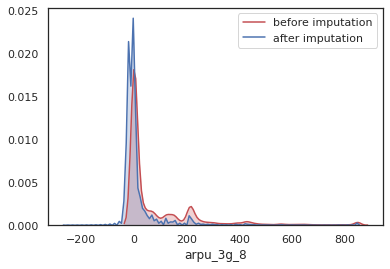

In [63]:
sns.kdeplot(df_copy['arpu_3g_8'], color='r', shade=True, Label='before imputation') 
  
sns.kdeplot(df['arpu_3g_8'], color='b', shade=True, Label='after imputation') 
  
plt.xlabel('arpu_3g_8') 


The plot for the imputed columns have a peak at 0 since there are large number of users who dont use the 3g data. The rest of the plot looks almost similar

Text(0.5, 0, 'count_rech_2g_6')

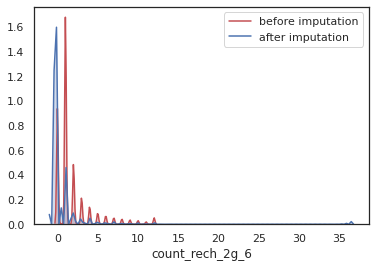

In [80]:
sns.kdeplot(df_copy['count_rech_2g_6'], color='r', shade=True, Label='before imputation') 
  
sns.kdeplot(df['count_rech_2g_6'], color='b', shade=True, Label='after imputation') 
  
plt.xlabel('count_rech_2g_6') 


The plots look to have similar distribution.

All the other columns with large differences are also related to the internet data where there are very high missing values

In [69]:
# Lets count the columns with greater than 10 difference of standard deviation
std_diff[std_diff>3].count()

23

In [82]:
df.shape

(93999, 128)

In [51]:
# Calculating VIF scores for predicting multicollinearity
vif_df = pd.DataFrame()
X=df.drop(columns=['mobile_number','churn'])
vif_df["variables"] = X.columns
vif_df["value"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif_df["value"]=vif_df['value'].round(2)
vif_df.sort_values(by='value',ascending=False,inplace=True)
vif_df.head()

,variables,value
20,std_og_mou_8,9.719985e+09
117,std_og_mou_t_8,9.719880e+09
19,std_og_mou_7,9.704329e+09
116,std_og_mou_t_7,9.704246e+09
18,std_og_mou_6,8.930008e+09


In [52]:
# It implies that there is some serious multicollinearity 
print(vif_df.shape[0])
vif_df[vif_df.value>=11].count()

126


variables    73
value        73
dtype: int64

After looking into vif values deeply, features ending with <b>mou</b> and <b>mou_t</b> have highest vif values. One of them can be reomoved. Similarly either of <b> total_og</b> , <b> total_ic</b> and <b> max_rech</b> , <b>total_rech</b> can be removed

### Observations from EDA

We have analysed all the important features in detail. From these the common thing that we observed is that the churned customers have high numbers in the 6th and 7th months but a fall in this can be observed for the eighth month. This is common for most of the churned customers but not for all

High correlations are observed between 6,7th months and 7,8th months

Recharge amounts distinguish better than the other features

For most of the features, the points overlap. Hence a clear seperation could not be found

Most of the churned customers have low values. Especially in the eighth month

The pair plots show that the most of the churned customers have close to 0 value in either of the two column values

Multicollinearity can be seen for some of the features since there are multiple features representing the same task

### Observations from Feature Engineering

As a part of feature engineering, we have added two features:
1. Fall_arpu : This represents how much fall/increase perecent is recorded for the 8th month compared to the average of 6,7th months in the average revenue
2. Fall_og: This represents how much fall/increase perecent is recorded for the 8th month compared to the average of 6,7th months in the outgoing calls

If there is an increase, it is represented by a positive number and if there is a drop, it will be represented by a negative number

The higher the number, lesser the chance of churning

## Modelling

In [47]:
y=df['churn']
x=df.drop(columns=['mobile_number','churn'])

In [48]:
scaler = preprocessing.StandardScaler().fit(x)
X = scaler.transform(x)


In [49]:
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.20)

X_train, X_cv, y_train, y_cv = train_test_split(X_train, y_train,test_size=0.20)

In [50]:
def plot_confusion_matrix(cm, classes,title='Confusion matrix',cmap=plt.cm.Blues):
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    


### Decision Tree

In [53]:
depth=[1, 5, 10, 50, 100, 500, 100]
sample_split=[5, 10, 100, 500] 
param_grid = {'max_depth':depth,'min_samples_split':sample_split} 
#Using GridSearchCV #
model_dt1 = GridSearchCV(DecisionTreeClassifier(class_weight='balanced'), param_grid, scoring = 'roc_auc', cv=5) 
model_dt1.fit(X_train,y_train) 
#print(model_d1.best_estimator_)
#filename = 'model1_dt'+str(i)
#pickle.dump(model_dt1, open(filename, 'wb'))
print(model_dt1.best_estimator_)
print(model_dt1.score(X_test, y_test))

DecisionTreeClassifier(class_weight='balanced', max_depth=5,
                       min_samples_split=500)
0.9048954662997317


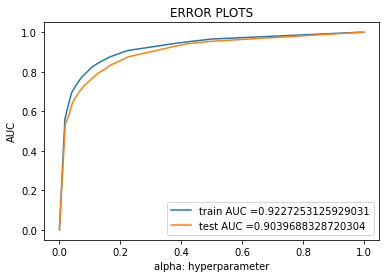

In [54]:
# Auc-error plots
y_train_proba=model_dt1.predict_proba(X_train)
y_train_proba=y_train_proba[:,1]
y_test_proba=model_dt1.predict_proba(X_test)
y_test_proba=y_test_proba[:,1]
train_fpr, train_tpr, thresholds = roc_curve(y_train, y_train_proba)
test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_proba)

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("alpha: hyperparameter")
plt.ylabel("AUC")
plt.title("ERROR PLOTS")
plt.show()

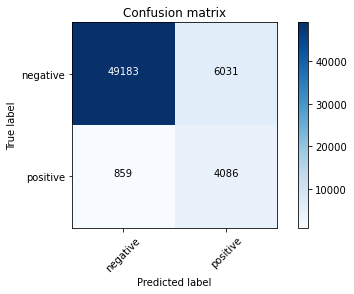

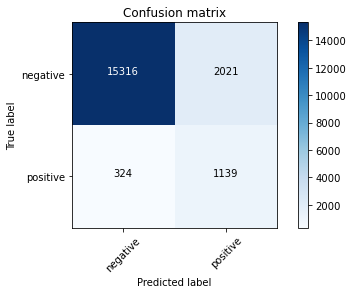

In [55]:
# Confusion Matrix
y_pred_test = model_dt1.predict(X_test)
y_pred_train=model_dt1.predict(X_train)
plot_confusion_matrix(confusion_matrix(y_train, y_pred_train), ["negative", "positive"])
plt.show()
plot_confusion_matrix(confusion_matrix(y_test, y_pred_test), ["negative", "positive"])
plt.show()

### Logistic Regression

In [54]:
# Hyperparameter tuning
c_val=[10**-4, 10**-3, 10**-2, 10**-1, 10**0, 10**1, 10**2, 10**3, 10**4]
#solvers = ['newton-cg', 'lbfgs', 'liblinear']
tuned_parameters = {'C': c_val}

model = GridSearchCV(LogisticRegression(penalty='l2',class_weight='balanced'), tuned_parameters, scoring = 'roc_auc', cv=5)
model.fit(X_train, y_train)

print(model.best_estimator_)
print(model.score(X_test, y_test))

LogisticRegression(C=1000, class_weight='balanced')
0.8851054162416074


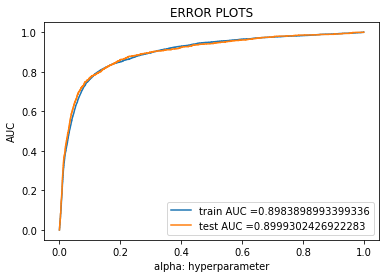

In [60]:
# Auc-error plots
y_train_proba=model.predict_proba(X_train)
y_train_proba=y_train_proba[:,1]
y_test_proba=model.predict_proba(X_test)
y_test_proba=y_test_proba[:,1]
train_fpr, train_tpr, thresholds = roc_curve(y_train, y_train_proba)
test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_proba)

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("alpha: hyperparameter")
plt.ylabel("AUC")
plt.title("ERROR PLOTS")
plt.show()

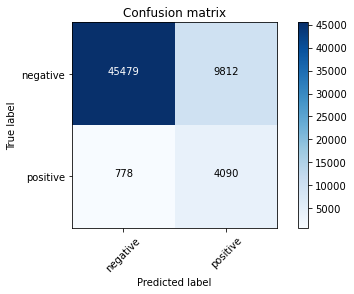

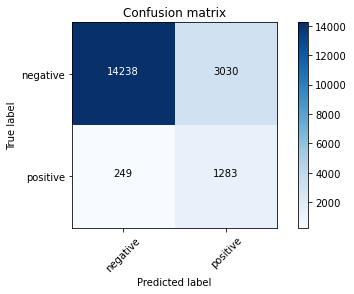

In [61]:
# Confusion Matrix
y_pred_test = model.predict(X_test)
y_pred_train=model.predict(X_train)
plot_confusion_matrix(confusion_matrix(y_train, y_pred_train), ["negative", "positive"])
plt.show()
plot_confusion_matrix(confusion_matrix(y_test, y_pred_test), ["negative", "positive"])
plt.show()

## Random Forests

In [55]:
# Hyperparameter tuning
depth = [5,10,30,50,100,120,150]
base_learners = [100, 200, 300, 400, 500]
param_grid = {'max_depth':depth,'n_estimators':base_learners}
#Using GridSearchCV
#model = GridSearchCV(SGDClassifier(loss='hinge'), param_grid, scoring = 'f1_micro', cv=3 ,
model1_rf = RandomizedSearchCV(RandomForestClassifier(class_weight='balanced'), param_grid, scoring='f1',cv=5)
model1_rf.fit(X_train, y_train)
print(model1_rf.best_estimator_)
print(model1_rf.score(X_test, y_test))

RandomForestClassifier(class_weight='balanced', max_depth=10)
0.6329405001437194


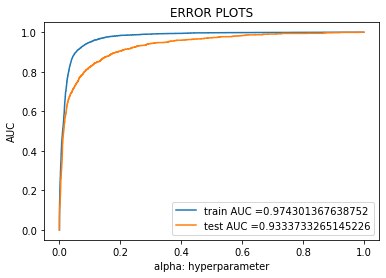

In [56]:
#Auc-Error plots
y_train_proba=model1_rf.predict_proba(X_train)
y_train_proba=y_train_proba[:,1]
y_test_proba=model1_rf.predict_proba(X_test)
y_test_proba=y_test_proba[:,1]
train_fpr, train_tpr, thresholds = roc_curve(y_train, y_train_proba)
test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_proba)

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("alpha: hyperparameter")
plt.ylabel("AUC")
plt.title("ERROR PLOTS")
plt.show()

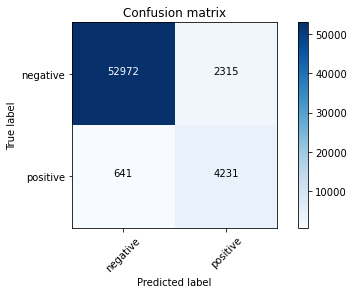

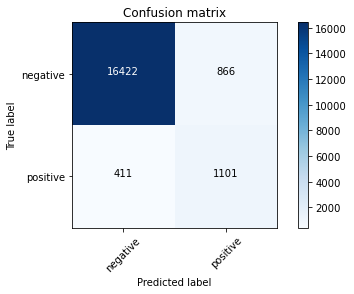

In [57]:
# Confusion Matrix
y_pred_test = model1_rf.predict(X_test)
y_pred_train=model1_rf.predict(X_train)
plot_confusion_matrix(confusion_matrix(y_train, y_pred_train), ["negative", "positive"])
plt.show()
plot_confusion_matrix(confusion_matrix(y_test, y_pred_test), ["negative", "positive"])
plt.show()

In [58]:
filename = 'model1_rf'
pickle.dump(model1_rf, open(filename, 'wb'))

In [78]:
# Important features
importances = model_rf.feature_importances_
std = np.std([i.feature_importances_ for i in model_rf.estimators_],
             axis=0)
indices = np.argsort(importances)[::-1]

# Print the feature ranking
print("Feature ranking:")

for f in range(X_train.shape[1]):
    print(f+ 1,x.columns[indices[f]],'---->' ,round(importances[indices[f]],4))

Feature ranking:
1 total_ic_mou_8 ----> 0.0995
2 fall_arpu ----> 0.0662
3 fall_og ----> 0.0643
4 total_og_mou_8 ----> 0.0625
5 roam_og_mou_8 ----> 0.0455
6 loc_ic_mou_8 ----> 0.042
7 last_day_rch_amt_8 ----> 0.0395
8 loc_ic_mou_t_8 ----> 0.038
9 arpu_8 ----> 0.038
10 roam_ic_mou_8 ----> 0.0371
11 total_rech_amt_8 ----> 0.0322
12 av_rech_amt_data_8 ----> 0.029
13 loc_og_mou_8 ----> 0.0248
14 max_rech_data_8 ----> 0.0214
15 max_rech_amt_8 ----> 0.0203
16 loc_og_mou_t_8 ----> 0.0187
17 arpu_2g_8 ----> 0.0146
18 arpu_3g_8 ----> 0.0144
19 loc_ic_mou_7 ----> 0.0101
20 std_ic_mou_8 ----> 0.0083
21 av_rech_amt_data_7 ----> 0.0083
22 av_rech_amt_data_6 ----> 0.0083
23 loc_ic_mou_t_7 ----> 0.0082
24 spl_ic_mou_8 ----> 0.0081
25 total_ic_mou_7 ----> 0.0072
26 std_ic_mou_t_8 ----> 0.0071
27 offnet_mou_8 ----> 0.007
28 aon ----> 0.0062
29 loc_ic_mou_6 ----> 0.0062
30 count_rech_3g_6 ----> 0.0062
31 std_og_mou_8 ----> 0.0059
32 total_og_mou_7 ----> 0.0057
33 onnet_mou_8 ----> 0.0055
34 arpu_2g_7 ---

<b>As we have expected, fall_arpu and fall_og features proved to be one of the most important features

In [53]:
from sklearn.metrics import accuracy_score
model1_rf=pickle.load(open('model1_rf','rb'))
pred=model1_rf.predict(X_cv)
#accuracy = model1_rf.evaluate(X_cv, y_cv)
accuracy_score(y_cv, pred)

0.9441489361702128

## Xgboost

In [52]:
# Hyperparameter tuning
depth = [5,20,50,100,150,200]
base_learners = [100, 200, 300, 400, 500]
param_grid = {'max_depth':depth,'n_estimators':base_learners}
#Using GridSearchCV #model = GridSearchCV(SGDClassifier(loss='hinge'), param_grid, scoring = 'f1_micro', cv=3 ,
model1_gb = GridSearchCV(XGBClassifier(), param_grid, scoring = 'f1',cv=5)
model1_gb.fit(X_train, y_train)
print(model1_gb.best_estimator_)
print(model1_gb.score(X_test, y_test))

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=5,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)
0.619345347554248


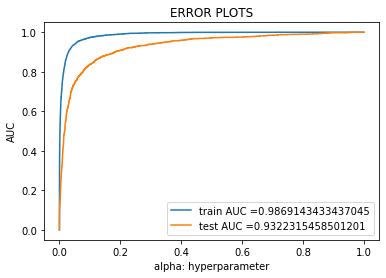

In [53]:
# Auc-Error plots
y_train_proba=model1_gb.predict_proba(X_train)
y_train_proba=y_train_proba[:,1]
y_test_proba=model1_gb.predict_proba(X_test)
y_test_proba=y_test_proba[:,1]
train_fpr, train_tpr, thresholds = roc_curve(y_train, y_train_proba)
test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_proba)

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("alpha: hyperparameter")
plt.ylabel("AUC")
plt.title("ERROR PLOTS")
plt.show()

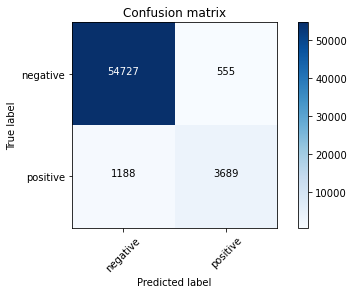

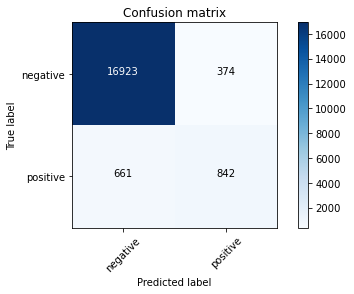

In [54]:
# Confusion Matrix
y_pred_test = model1_gb.predict(X_test)
y_pred_train=model1_gb.predict(X_train)
plot_confusion_matrix(confusion_matrix(y_train, y_pred_train), ["negative", "positive"])
plt.show()
plot_confusion_matrix(confusion_matrix(y_test, y_pred_test), ["negative", "positive"])
plt.show()

In [55]:
filename = 'model1_gb'
pickle.dump(model1_gb, open(filename, 'wb'))

### Balancing the data using SMOTE

In [55]:
smt = SMOTE(random_state = 2) 
X_trainb,y_trainb = smt.fit_sample(X_train,y_train)


In [56]:
print(X_trainb.shape)
print(y_trainb.shape)

(110654, 126)
(110654,)


In [57]:
y_trainb.value_counts()

1.0    55327
0.0    55327
Name: churn, dtype: int64

In [58]:
# Hyperparameter tuning
c_val=[10**-4, 10**-2, 10**0, 10**2, 10**4]
#solvers = ['newton-cg', 'lbfgs', 'liblinear']
tuned_parameters = {'C': c_val}

modelb = GridSearchCV(LogisticRegression(penalty='l2'), tuned_parameters, scoring = 'roc_auc', cv=5)
modelb.fit(X_trainb, y_trainb)

print(modelb.best_estimator_)
print(modelb.score(X_test, y_test))

LogisticRegression(C=100)
0.8847592702426988


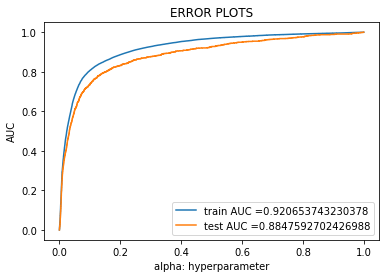

In [59]:
# Auc-error plots
y_train_proba=modelb.predict_proba(X_trainb)
y_train_proba=y_train_proba[:,1]
y_test_proba=modelb.predict_proba(X_test)
y_test_proba=y_test_proba[:,1]
train_fpr, train_tpr, thresholds = roc_curve(y_trainb, y_train_proba)
test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_proba)

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("alpha: hyperparameter")
plt.ylabel("AUC")
plt.title("ERROR PLOTS")
plt.show()

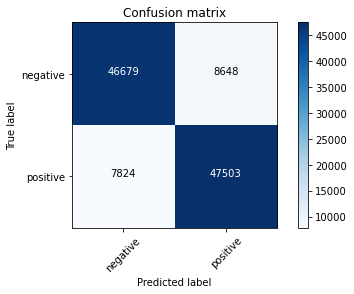

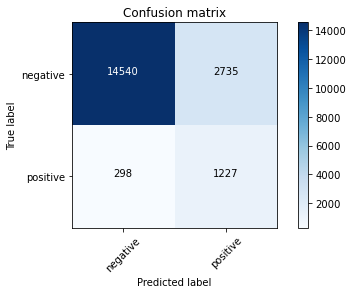

In [60]:
# Confusion Matrix
y_pred_test = modelb.predict(X_test)
y_pred_train=modelb.predict(X_trainb)
plot_confusion_matrix(confusion_matrix(y_trainb, y_pred_train), ["negative", "positive"])
plt.show()
plot_confusion_matrix(confusion_matrix(y_test, y_pred_test), ["negative", "positive"])
plt.show()

In [ ]:
# Hyperparameter tuning
depth = [5,20,50,100,150,200]
base_learners = [100, 200, 300, 400, 500]
param_grid = {'max_depth':depth,'n_estimators':base_learners}
#Using GridSearchCV #model = GridSearchCV(SGDClassifier(loss='hinge'), param_grid, scoring = 'f1_micro', cv=3 ,
model1_gbb = GridSearchCV(XGBClassifier(), param_grid, scoring = 'f1',cv=5)
model1_gbb.fit(X_train, y_train)
print(model1_gbb.best_estimator_)
print(model1_gbb.score(X_test, y_test))

In [ ]:
# Auc-Error plots
y_train_proba=model1_gbb.predict_proba(X_train)
y_train_proba=y_train_proba[:,1]
y_test_proba=model1_gbb.predict_proba(X_test)
y_test_proba=y_test_proba[:,1]
train_fpr, train_tpr, thresholds = roc_curve(y_train, y_train_proba)
test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_proba)

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("alpha: hyperparameter")
plt.ylabel("AUC")
plt.title("ERROR PLOTS")
plt.show()

In [ ]:
# Confusion Matrix
y_pred_test = model1_gbb.predict(X_test)
y_pred_train=model1_gbb.predict(X_trainb)
plot_confusion_matrix(confusion_matrix(y_trainb, y_pred_train), ["negative", "positive"])
plt.show()
plot_confusion_matrix(confusion_matrix(y_test, y_pred_test), ["negative", "positive"])
plt.show()

## PCA with Logistic regression

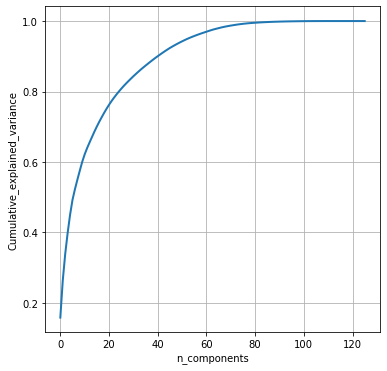

In [105]:
# PCA for dimensionality redcution (non-visualization)
pca = decomposition.PCA()

pca_data = pca.fit_transform(X)

percentage_var_explained = pca.explained_variance_ / np.sum(pca.explained_variance_);

cum_var_explained = np.cumsum(percentage_var_explained)

# Plot the PCA spectrum
plt.figure(1, figsize=(6, 6))

plt.clf()
plt.plot(cum_var_explained, linewidth=2)
plt.axis('tight')
plt.grid()
plt.xlabel('n_components')
plt.ylabel('Cumulative_explained_variance')
plt.show()

Lets try to preserve 100% of the variance and take 80 components

In [118]:
pca_com=decomposition.PCA(n_components=80)
train_pca=pca_com.fit_transform(X_train)
train_pca.shape

(60159, 80)

In [119]:
test_pca=pca_com.transform(X_test)

In [120]:
c_val=[10**-4, 10**-2, 10**0, 10**2, 10**4]
#solvers = ['newton-cg', 'lbfgs', 'liblinear']
tuned_parameters = {'C': c_val}
#X_train, X_test, y_train, y_test = train_test_split(data.data, data.target, train_size=.9)

model_pca = GridSearchCV(LogisticRegression(penalty='l2',class_weight='balanced'), tuned_parameters, scoring = 'roc_auc', cv=5)
model_pca.fit(train_pca, y_train)

print(model_pca.best_estimator_)
print(model_pca.score(test_pca, y_test))

LogisticRegression(C=10000, class_weight='balanced')
0.8960431799947635


Using PCA, the results are not as good as the previous model

In [119]:
from prettytable import PrettyTable 
x = PrettyTable() 
x.field_names=['Model','Auc'] 
x.add_row(['Decision Tree',0.9])
x.add_row(['Logistic Regression',0.899])
x.add_row(['Random forests',0.933])
x.add_row(['Xgboost',0.932]) 
x.add_row(['Logistic regression (SMOTE)',0.88])
x.add_row(['PCA + Logistic regression',0.896]) 
print(x)


+-----------------------------+-------+
|            Model            |  Auc  |
+-----------------------------+-------+
|        Decision Tree        |  0.9  |
|     Logistic Regression     | 0.899 |
|        Random forests       | 0.933 |
|           Xgboost           | 0.932 |
| Logistic regression (SMOTE) |  0.88 |
|  PCA + Logistic regression  | 0.896 |
+-----------------------------+-------+


## Observations

- The best auc score is producesd by xgboost model
- But logistic regression is doing good job in predicting the churn better while it makes mistakes by predicting the non churned customers as churned
- The auc score is almost similar when the points are balanced or not balanced
- Using PCA, is not giving that good results

## Ensemble based stacking models using decision trees as base learners

In [51]:
df.drop(columns='mobile_number',inplace=True)

In [52]:
df.head()

,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,...,std_og_mou_t_7,std_og_mou_t_8,loc_ic_mou_t_6,loc_ic_mou_t_7,loc_ic_mou_t_8,std_ic_mou_t_6,std_ic_mou_t_7,std_ic_mou_t_8,fall_arpu,fall_og
1,34.047,355.074,268.321,24.11,78.68,7.68,15.74,99.84,304.76,0.0,...,4.57,0.13,19.09,104.22,408.42,5.90,0.00,14.84,38.0,186.0
2,167.690,189.058,210.226,11.54,55.24,37.26,143.33,220.59,208.36,0.0,...,108.66,120.94,229.55,208.84,155.98,139.32,306.64,239.01,18.0,0.0
3,221.338,251.102,508.054,99.91,54.39,310.98,123.31,109.01,71.68,0.0,...,16.62,296.11,233.47,111.58,48.16,45.99,105.00,4.94,115.0,96.0
4,261.636,309.876,238.174,50.31,149.44,83.89,76.96,91.88,124.26,0.0,...,0.00,0.00,214.02,198.03,337.94,1.93,0.25,0.86,-17.0,13.0
5,50.258,58.810,83.386,50.16,43.63,85.48,19.28,13.44,14.46,0.0,...,4.61,2.08,77.92,87.47,118.72,77.03,71.06,37.93,53.0,58.0


In [53]:
df_=shuffle(df)
df_test=df_[:18800] # 20% of the data
df_train=df_[18800:] # 80% of the data

In [54]:
print(df_test.shape)
print(df_train.shape)

(18800, 127)
(75199, 127)


In [55]:
df_train_=shuffle(df_train)
train1=df_train_[:37600] # 50% of train data
train2=df_train_[37600:] # 50% of train data
print(train1.shape)
print(train2.shape)

(37600, 127)
(37599, 127)


In [56]:
y_test=df_test['churn']
x_test=df_test.drop(columns='churn')

y_train2=train2['churn']
x_train2=train2.drop(columns='churn')

In [56]:
def decisiontree(data,labels,i):
    depth=[1, 5, 10, 50, 100, 500, 100]
    sample_split=[5, 10, 100, 500] 
    param_grid = {'max_depth':depth,'min_samples_split':sample_split} 
    #Using GridSearchCV #
    model_dt1 = GridSearchCV(DecisionTreeClassifier(class_weight='balanced'), param_grid, scoring = 'roc_auc', cv=5) 
    model_dt1.fit(data, labels) 
    #print(model_d1.best_estimator_)
    print('Train auc score: ',model_dt1.score(data, labels))
    filename = 'model1_dt'+str(i)
    pickle.dump(model_dt1, open(filename, 'wb'))
    return model_dt1.predict(x_train2)

In [62]:
def xgboost(data):
    # Hyperparameter tuning
    depth = [5,20,50,100,150,200]
    base_learners = [100, 200, 300, 400, 500]
    param_grid = {'max_depth':depth,'n_estimators':base_learners}
    #Using GridSearchCV #model = GridSearchCV(SGDClassifier(loss='hinge'), param_grid, scoring = 'f1_micro', cv=3 ,
    model_gb_m1 = GridSearchCV(XGBClassifier(), param_grid, scoring = 'roc_auc',cv=5)
    model_gb_m1.fit(data, y_train2)
    print(model_gb_m1.best_estimator_)
    print("Train xgboost AUC score",model_gb_m1.score(data, y_train2))
    filename = 'model1_m'+str(data.shape[1])
    pickle.dump(model_gb_m1, open(filename, 'wb'))

In [63]:
dataset=pd.DataFrame()
def ensemble(num1,num2):
    for j in range(num1,num2):
        print('-------model '+str(j+1)+'--------')
        t=train1.sample(n=25000,replace=True)
        labels=t['churn']
        data=t.drop(columns='churn')
        predict=decisiontree(data,labels,j)
        dataset['d'+str(j)]=predict
    print(dataset.shape)
    xgboost(dataset)

In [ ]:
dataset7=pd.DataFrame()
for i in range(7):
    print('---------- model'+str(i)+'-----------')
    t=df.sample(n=25000,replace=True)
    labels=t['churn']
    data=t.drop(columns='churn')
    #predict=decisiontree(data,labels)
    depth=[1, 5, 10, 50, 100, 500, 100]
    sample_split=[5, 10, 100, 500] 
    param_grid = {'max_depth':depth,'min_samples_split':sample_split} 
    #Using GridSearchCV #
    model_d = GridSearchCV(DecisionTreeClassifier(class_weight='balanced'), param_grid, scoring = 'roc_auc', cv=5) 
    model_d.fit(data, labels) 
    filename = 'model1_d'+str(i)
    pickle.dump(model_d, open(filename, 'wb'))
    #print(model_d.best_estimator_)
    print(model_d.score(data, labels))
    predict= model_d.predict(x_train2)
    dataset7['d'+str(i)]=predict

In [60]:
xgboost(dataset7)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=5,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)
Train xgboost AUC score 0.9093611490264447


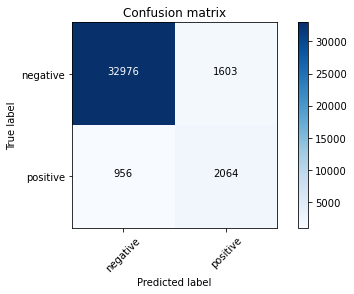

In [63]:
model1_m7 = pickle.load(open('model1_m7', 'rb'))

y_pred_train=model1_m7.predict(dataset7)

plot_confusion_matrix(confusion_matrix(y_train2, y_pred_train), ["negative", "positive"])
plt.show()

In [61]:
dataset7=pd.DataFrame()
for i in range(7):
    print('---------- model'+str(i)+'-----------')
    t=df.sample(n=25000,replace=True)
    labels=t['churn']
    data=t.drop(columns='churn')
    #predict=decisiontree(data,labels)
    depth=[1, 5, 10, 50, 100, 500, 100]
    sample_split=[5, 10, 100, 500] 
    param_grid = {'max_depth':depth,'min_samples_split':sample_split} 
    #Using GridSearchCV #
    model_d = GridSearchCV(DecisionTreeClassifier(class_weight='balanced'), param_grid, scoring = 'roc_auc', cv=5) 
    model_d.fit(data, labels) 
    filename = 'model_d'+str(i)
    pickle.dump(model_d, open(filename, 'wb'))
    #print(model_d.best_estimator_)
    print(model_d.score(data, labels))
    predict= model_d.predict(x_train2)
    dataset7['d'+str(i)]=predict

---------- model0-----------
0.9541335468833836
---------- model1-----------
0.9291084046394196
---------- model2-----------
0.9553995049983044
---------- model3-----------
0.9512891052460527
---------- model4-----------
0.924889440072372
---------- model5-----------
0.9576746250216924
---------- model6-----------
0.9612321517148525


In [62]:
model_meta7=XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=5,
              min_child_weight=1, monotone_constraints='()',
              n_estimators=100, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)
model_meta7.fit(dataset7,y_train2)
filename = 'model_meta7'+str(i)
pickle.dump(model_meta7, open(filename, 'wb'))

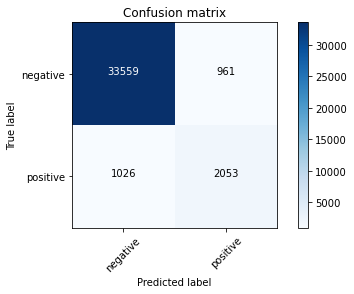

In [65]:
y_pred_train=model_meta7.predict(dataset7)

plot_confusion_matrix(confusion_matrix(y_train2, y_pred_train), ["negative", "positive"])
plt.show()

In [57]:
model1_dt0 = pickle.load(open('model1_dt0', 'rb'))
model1_dt1 = pickle.load(open('model1_dt1', 'rb'))
model1_dt2 = pickle.load(open('model1_dt2', 'rb'))
model1_dt3 = pickle.load(open('model1_dt3', 'rb'))
model1_dt4 = pickle.load(open('model1_dt4', 'rb'))
model1_dt5 = pickle.load(open('model1_dt5', 'rb'))
model1_dt6 = pickle.load(open('model1_dt6', 'rb'))
model1_dt7 = pickle.load(open('model1_dt7', 'rb'))
model1_dt8 = pickle.load(open('model1_dt8', 'rb'))
model1_dt9 = pickle.load(open('model1_dt9', 'rb'))
model1_dt10 = pickle.load(open('model1_dt10', 'rb'))
model1_dt11 = pickle.load(open('model1_dt11', 'rb'))
model1_dt12 = pickle.load(open('model1_dt12', 'rb'))
model1_dt13 = pickle.load(open('model1_dt13', 'rb'))
model1_dt14 = pickle.load(open('model1_dt14', 'rb'))
model1_dt15 = pickle.load(open('model1_dt15', 'rb'))
model1_dt16 = pickle.load(open('model1_dt16', 'rb'))
model1_dt17 = pickle.load(open('model1_dt17', 'rb'))
model1_dt18 = pickle.load(open('model1_dt18', 'rb'))
model1_dt19 = pickle.load(open('model1_dt19', 'rb'))
model1_dt20 = pickle.load(open('model1_dt20', 'rb'))
model1_dt21 = pickle.load(open('model1_dt21', 'rb'))
model1_dt22 = pickle.load(open('model1_dt22', 'rb'))
model1_dt23 = pickle.load(open('model1_dt23', 'rb'))
model1_dt24 = pickle.load(open('model1_dt24', 'rb'))
model1_m25 = pickle.load(open('model1_m25', 'rb'))
model1_dt25 = pickle.load(open('model1_dt25', 'rb'))
model1_dt26 = pickle.load(open('model1_dt26', 'rb'))
model1_dt27 = pickle.load(open('model1_dt27', 'rb'))
model1_dt28 = pickle.load(open('model1_dt28', 'rb'))
model1_dt29 = pickle.load(open('model1_dt29', 'rb'))
model1_dt30 = pickle.load(open('model1_dt30', 'rb'))
model1_dt31 = pickle.load(open('model1_dt31', 'rb'))
model1_dt32 = pickle.load(open('model1_dt32', 'rb'))
model1_dt33 = pickle.load(open('model1_dt33', 'rb'))
model1_dt34 = pickle.load(open('model1_dt34', 'rb'))
model1_dt35 = pickle.load(open('model1_dt35', 'rb'))
model1_dt36 = pickle.load(open('model1_dt36', 'rb'))
model1_dt37 = pickle.load(open('model1_dt37', 'rb'))
model1_dt38 = pickle.load(open('model1_dt38', 'rb'))
model1_dt39 = pickle.load(open('model1_dt39', 'rb'))
'''
model1_dt40 = pickle.load(open('model1_dt40', 'rb'))
model1_dt41 = pickle.load(open('model1_dt41', 'rb'))
model1_dt42 = pickle.load(open('model1_dt42', 'rb'))
model1_dt43 = pickle.load(open('model1_dt43', 'rb'))
model1_dt44 = pickle.load(open('model1_dt44', 'rb'))
model1_dt45 = pickle.load(open('model1_dt45', 'rb'))
model1_dt46 = pickle.load(open('model1_dt46', 'rb'))
model1_dt47 = pickle.load(open('model1_dt47', 'rb'))
model1_dt48 = pickle.load(open('model1_dt48', 'rb'))
model1_dt49 = pickle.load(open('model1_dt49', 'rb'))
'''
model1_m40 = pickle.load(open('model1_m40', 'rb'))


In [73]:
model=[model1_dt0,model1_dt1,model1_dt2,model1_dt3,model1_dt4,model1_dt5,model1_dt6,model1_dt7,model1_dt8,model1_dt9,model1_dt10,
       model1_dt11,model1_dt12,model1_dt13,model1_dt14,model1_dt15,model1_dt16,model1_dt17,model1_dt18,model1_dt19,model1_dt20,
      model1_dt21,model1_dt22,model1_dt23,model1_dt24,model1_dt25,model1_dt26,model1_dt27,model1_dt28,model1_dt29,
      model1_dt30,model1_dt31,model1_dt32,model1_dt33,model1_dt34,model1_dt35,model1_dt36,model1_dt37,model1_dt38,
       model1_dt39]


In [59]:
len(model)

40

In [60]:
dataset=pd.DataFrame()
print(dataset.shape)
for i in range(len(model)):
    predict=model[i].predict(x_train2)
    dataset['d'+str(i)]=predict

(0, 0)


In [61]:
print(dataset.shape)


(37599, 40)


In [78]:
dataset.head()

,d0,d1,d2,d3,d4,d5,d6,d7,d8,d9,...,d40,d41,d42,d43,d44,d45,d46,d47,d48,d49
0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [83]:
xgboost(dataset)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=5,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)
Train xgboost AUC score 0.9626603657171299


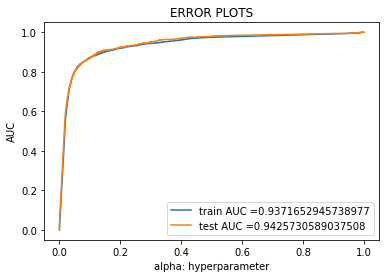

In [66]:
test_dataset=pd.DataFrame()
for i in range(len(model)):
    predict=model[i].predict(x_test)
    test_dataset['d'+str(i)]=predict
#model1_meta= pickle.load(open('model_meta76', 'rb'))  

# Auc-error plots
y_train_proba=model1_m40.predict_proba(dataset)
y_train_proba=y_train_proba[:,1]
y_test_proba=model1_m40.predict_proba(test_dataset)
y_test_proba=y_test_proba[:,1]
train_fpr, train_tpr, thresholds = roc_curve(y_train2, y_train_proba)
test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_proba)

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("alpha: hyperparameter")
plt.ylabel("AUC")
plt.title("ERROR PLOTS")
plt.show()

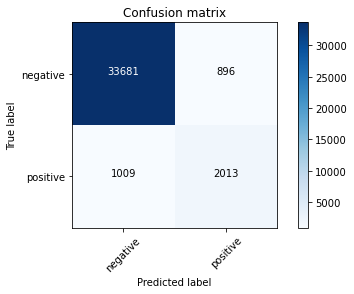

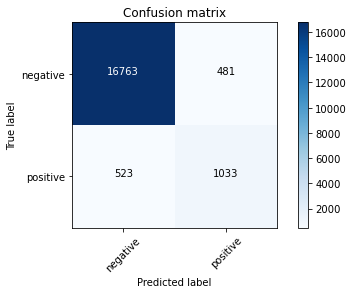

In [63]:
# Confusion Matrix
y_pred_test = model1_m40.predict(test_dataset)
y_pred_train=model1_m40.predict(dataset)
plot_confusion_matrix(confusion_matrix(y_train2, y_pred_train), ["negative", "positive"])
plt.show()
plot_confusion_matrix(confusion_matrix(y_test, y_pred_test), ["negative", "positive"])
plt.show()

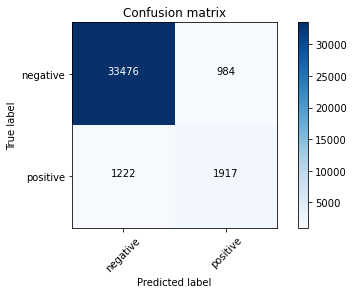

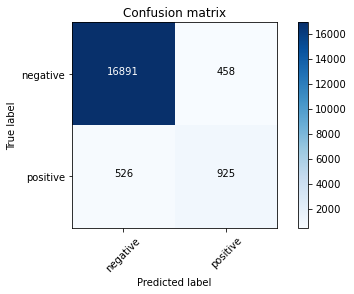

In [72]:
# Confusion Matrix
y_pred_test = model1_m25.predict(test_dataset)
y_pred_train=model1_m25.predict(dataset)
plot_confusion_matrix(confusion_matrix(y_train2, y_pred_train), ["negative", "positive"])
plt.show()
plot_confusion_matrix(confusion_matrix(y_test, y_pred_test), ["negative", "positive"])
plt.show()

After trying with 7 base learners, the auc is 0.93. But the model is not good in predicting the churn accurately. Lets try with more number of base learners and see how they are performing

In [83]:
temp=dataset.shape[1]

In [84]:
temp

5

In [85]:
num=[7,10,12,15,20,25]
for i in num:
    temp=dataset.shape[1]
    ensemble(temp,i)

-------model 6--------
Train auc score:  0.9255697592263071
-------model 7--------
Train auc score:  0.9397427452772599
(37599, 7)
XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=5,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)
Train xgboost AUC score 0.92304177990007
-------model 8--------
Train auc score:  0.9233789932605786
-------model 9--------
Train auc score:  0.9558016667703215
-------model 10--------
Train auc score:  0.9461203271603155
(37599, 10)
XGBClassifier(base_score=0.5, booster='gbtree', colsa

In [76]:
dataset.shape

(25000, 5)

In [ ]:
dataset.shape[1]

In [ ]:
#nums=[5,10,15,20,25,30]
for i in range(5,35,5):
    temp=dataset.shape[1]
    ensemble(temp,i)
    

-------model 1--------
Train auc score:  0.9535863344006269
-------model 2--------
Train auc score:  0.9283323724697587
-------model 3--------
Train auc score:  0.9520258240750277
-------model 4--------
Train auc score:  0.9597313362777322
-------model 5--------
Train auc score:  0.9517826993346648
(37599, 5)
XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=5,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)
Train xgboost AUC score 0.9260587886349438
-------model 6--------
Train auc score:  0.95958581212494
------

In [72]:
xgboost(dataset)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=5,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)
Train xgboost AUC score 0.9599735712907962


In [68]:
#print(model_d1.best_estimator_)
print('Train auc score: ',model_dt1.score(dl, sl))
filename = 'model_dt'+str(13)
pickle.dump(model_dt1, open(filename, 'wb'))
pred=model_dt1.predict(x_train2)
dataset['d13']=pred

Train auc score:  0.9566715451424472


In [70]:
dataset.shape

(37599, 15)

In [71]:
dataset.head(2)

,d0,d1,d2,d3,d4,d5,d6,d7,d8,d9,d10,d11,d12,d13,d14
0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [58]:
dataset15=pd.DataFrame()
for i in range(15):
        t=df.sample(n=25000,replace=True)
        labels=t['churn']
        data=t.drop(columns='churn')
        predict=decisiontree(data,labels)
        dataset15['d'+str(i)]=predict

In [62]:
model_meta=XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=5,
              min_child_weight=1, monotone_constraints='()',
              n_estimators=100, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)
model_meta.fit(dataset15,y_train2)


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=5,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

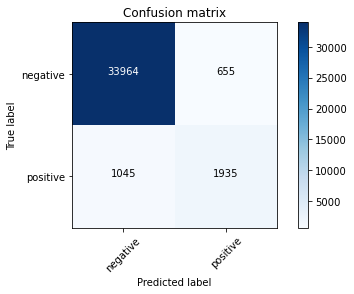

In [69]:
y_pred_train=model1_m25.predict(dataset)

plot_confusion_matrix(confusion_matrix(y_train2, y_pred_train), ["negative", "positive"])
plt.show()

In [67]:
print('Train auc score :',model1_m40.score(dataset,y_train2))

Train auc score : 0.9371652945738977


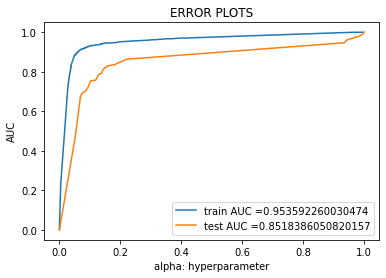

In [91]:
test_dataset=pd.DataFrame()
for i in range(len(model)):
    predict=model[i].predict(x_test)
    test_dataset['d'+str(i)]=predict

# Auc-error plots
y_train_proba=model1_m25.predict_proba(dataset)
y_train_proba=y_train_proba[:,1]
y_test_proba=model1_m25.predict_proba(test_dataset)
y_test_proba=y_test_proba[:,1]
train_fpr, train_tpr, thresholds = roc_curve(y_train2, y_train_proba)
test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_proba)

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("alpha: hyperparameter")
plt.ylabel("AUC")
plt.title("ERROR PLOTS")
plt.show()

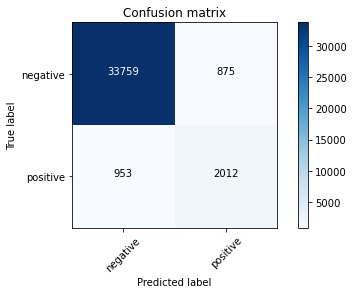

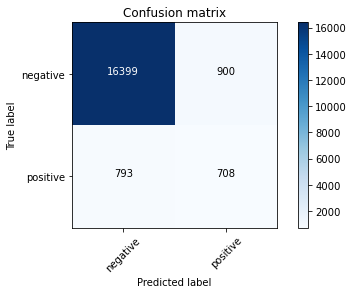

In [94]:
# Confusion Matrix
y_pred_test = model1_m25.predict(test_dataset)
y_pred_train=model1_m25.predict(dataset)
plot_confusion_matrix(confusion_matrix(y_train2, y_pred_train), ["negative", "positive"])
plt.show()
plot_confusion_matrix(confusion_matrix(y_test, y_pred_test), ["negative", "positive"])
plt.show()

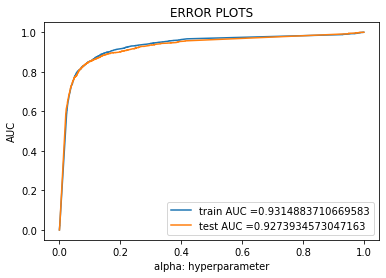

In [65]:
test_dataset=pd.DataFrame()
for i in range(len(model)):
    predict=model[i].predict(x_test)
    test_dataset['d'+str(i)]=predict

# Auc-error plots
y_train_proba=model1_m25.predict_proba(dataset)
y_train_proba=y_train_proba[:,1]
y_test_proba=model1_m25.predict_proba(test_dataset)
y_test_proba=y_test_proba[:,1]
train_fpr, train_tpr, thresholds = roc_curve(y_train2, y_train_proba)
test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_proba)

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("alpha: hyperparameter")
plt.ylabel("AUC")
plt.title("ERROR PLOTS")
plt.show()

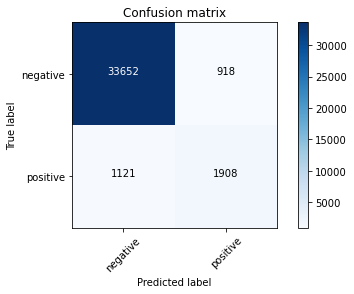

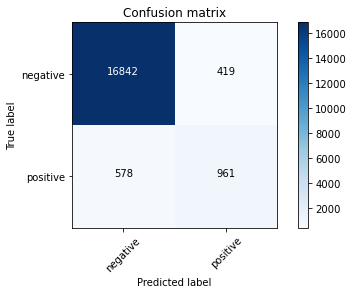

In [66]:
# Confusion Matrix
y_pred_test = model1_m25.predict(test_dataset)
y_pred_train=model1_m25.predict(dataset)
plot_confusion_matrix(confusion_matrix(y_train2, y_pred_train), ["negative", "positive"])
plt.show()
plot_confusion_matrix(confusion_matrix(y_test, y_pred_test), ["negative", "positive"])
plt.show()

In [62]:
for i in range(50,60,10):
    temp=dataset.shape[1]
    ensemble(temp,i)

(37599, 50)
XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=5,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)
Train xgboost AUC score 0.9700103255755407


In [65]:
model1_dt0 = pickle.load(open('model1_dt0', 'rb'))
model1_dt1 = pickle.load(open('model1_dt1', 'rb'))
model1_dt2 = pickle.load(open('model1_dt2', 'rb'))
model1_dt3 = pickle.load(open('model1_dt3', 'rb'))
model1_dt4 = pickle.load(open('model1_dt4', 'rb'))
model1_dt5 = pickle.load(open('model1_dt5', 'rb'))
model1_dt6 = pickle.load(open('model1_dt6', 'rb'))
model1_dt7 = pickle.load(open('model1_dt7', 'rb'))
model1_dt8 = pickle.load(open('model1_dt8', 'rb'))
model1_dt9 = pickle.load(open('model1_dt9', 'rb'))
model1_dt10 = pickle.load(open('model1_dt10', 'rb'))
model1_dt11 = pickle.load(open('model1_dt11', 'rb'))
model1_dt12 = pickle.load(open('model1_dt12', 'rb'))
model1_dt13 = pickle.load(open('model1_dt13', 'rb'))
model1_dt14 = pickle.load(open('model1_dt14', 'rb'))
model1_dt15 = pickle.load(open('model1_dt15', 'rb'))
model1_dt16 = pickle.load(open('model1_dt16', 'rb'))
model1_dt17 = pickle.load(open('model1_dt17', 'rb'))
model1_dt18 = pickle.load(open('model1_dt18', 'rb'))
model1_dt19 = pickle.load(open('model1_dt19', 'rb'))
model1_dt20 = pickle.load(open('model1_dt20', 'rb'))
model1_dt21 = pickle.load(open('model1_dt21', 'rb'))
model1_dt22 = pickle.load(open('model1_dt22', 'rb'))
model1_dt23 = pickle.load(open('model1_dt23', 'rb'))
model1_dt24 = pickle.load(open('model1_dt24', 'rb'))
model1_dt25 = pickle.load(open('model1_dt25', 'rb'))
model1_dt26 = pickle.load(open('model1_dt26', 'rb'))
model1_dt27 = pickle.load(open('model1_dt27', 'rb'))
model1_dt28 = pickle.load(open('model1_dt28', 'rb'))
model1_dt29 = pickle.load(open('model1_dt29', 'rb'))
model1_dt30 = pickle.load(open('model1_dt30', 'rb'))
model1_dt31 = pickle.load(open('model1_dt31', 'rb'))
model1_dt32 = pickle.load(open('model1_dt32', 'rb'))
model1_dt33 = pickle.load(open('model1_dt33', 'rb'))
model1_dt34 = pickle.load(open('model1_dt34', 'rb'))
model1_dt35 = pickle.load(open('model1_dt35', 'rb'))
model1_dt36 = pickle.load(open('model1_dt36', 'rb'))
model1_dt37 = pickle.load(open('model1_dt37', 'rb'))
model1_dt38 = pickle.load(open('model1_dt38', 'rb'))
model1_dt39 = pickle.load(open('model1_dt39', 'rb'))
model1_dt40 = pickle.load(open('model1_dt40', 'rb'))
model1_dt41 = pickle.load(open('model1_dt41', 'rb'))
model1_dt42 = pickle.load(open('model1_dt42', 'rb'))
model1_dt43 = pickle.load(open('model1_dt43', 'rb'))
model1_dt44 = pickle.load(open('model1_dt44', 'rb'))
model1_dt45 = pickle.load(open('model1_dt45', 'rb'))
model1_dt46 = pickle.load(open('model1_dt46', 'rb'))
model1_dt47 = pickle.load(open('model1_dt47', 'rb'))
model1_dt48 = pickle.load(open('model1_dt48', 'rb'))
model1_dt49 = pickle.load(open('model1_dt49', 'rb'))

model1_m50 = pickle.load(open('model1_m50', 'rb'))


In [65]:
model_m50=XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=5,
              min_child_weight=1, monotone_constraints='()',
              n_estimators=100, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)
model_m50.fit(dataset,y_train2)
print('Train auc score :',model_m50.score(dataset,y_train2))

Train auc score : 0.9682970291763079


In [ ]:
model=[model_dt0,model_dt1,model_dt2,model_dt3,model_dt4,model_dt5,model_dt6,model_dt7,model_dt8,model_dt9,model_dt10,
       model_dt11,model_dt12,model_dt13,model_dt14,model_dt15,model_dt16,model_dt17,model_dt18,model_dt19,model_dt20,
      model_dt21,model_dt22,model_dt23,model_dt24,model_dt25,model_dt26,model_dt27,model_dt28,model_dt29,
      model_dt30,model_dt31,model_dt32,model_dt33,model_dt34,model_dt35,model_dt36,model_dt37,model_dt38,model_dt39,
      model_dt40,model_dt41,model_dt42,model_dt43,model_dt44,model_dt45,model_dt46,model_dt47,model_dt48,model_dt49]

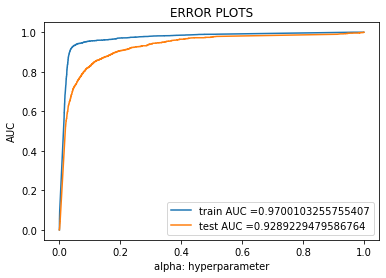

In [79]:
test_dataset=pd.DataFrame()
for i in range(len(model)):
    predict=model[i].predict(x_test)
    test_dataset['d'+str(i)]=predict

# Auc-error plots
y_train_proba=model1_m50.predict_proba(dataset)
y_train_proba=y_train_proba[:,1]
y_test_proba=model1_m50.predict_proba(test_dataset)
y_test_proba=y_test_proba[:,1]
train_fpr, train_tpr, thresholds = roc_curve(y_train2, y_train_proba)
test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_proba)

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("alpha: hyperparameter")
plt.ylabel("AUC")
plt.title("ERROR PLOTS")
plt.show()

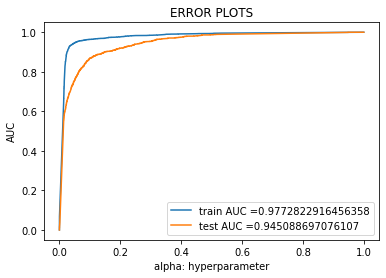

In [73]:
test_dataset=pd.DataFrame()
for i in range(len(model)):
    predict=model[i].predict(x_test)
    test_dataset['d'+str(i)]=predict

# Auc-error plots
y_train_proba=model_m50.predict_proba(dataset)
y_train_proba=y_train_proba[:,1]
y_test_proba=model_m50.predict_proba(test_dataset)
y_test_proba=y_test_proba[:,1]
train_fpr, train_tpr, thresholds = roc_curve(y_train2, y_train_proba)
test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_proba)

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("alpha: hyperparameter")
plt.ylabel("AUC")
plt.title("ERROR PLOTS")
plt.show()

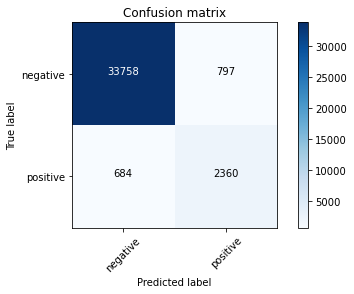

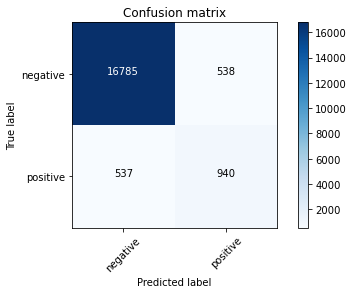

In [80]:
# Confusion Matrix
y_pred_test = model1_m50.predict(test_dataset)
y_pred_train=model1_m50.predict(dataset)
plot_confusion_matrix(confusion_matrix(y_train2, y_pred_train), ["negative", "positive"])
plt.show()
plot_confusion_matrix(confusion_matrix(y_test, y_pred_test), ["negative", "positive"])
plt.show()

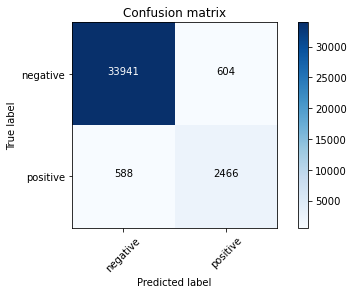

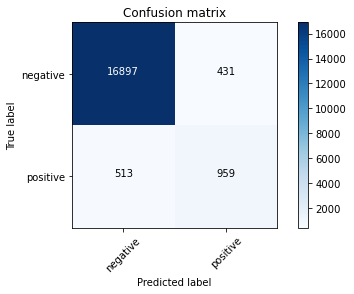

In [74]:
# Confusion Matrix
y_pred_test = model_m50.predict(test_dataset)
y_pred_train=model_m50.predict(dataset)
plot_confusion_matrix(confusion_matrix(y_train2, y_pred_train), ["negative", "positive"])
plt.show()
plot_confusion_matrix(confusion_matrix(y_test, y_pred_test), ["negative", "positive"])
plt.show()

In [62]:
dataset.shape[1]

50

In [63]:
xgboost(dataset)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=5,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)
Train xgboost AUC score 0.974281057432657


In [63]:
xgboost(dataset)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=5,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)
Train xgboost AUC score 0.9781179136959358


In [65]:
model_m50 = pickle.load(open('model_m50', 'rb'))

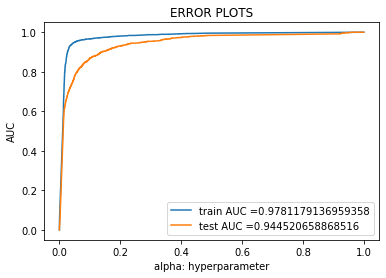

In [66]:
test_dataset=pd.DataFrame()
for i in range(len(model)):
    predict=model[i].predict(x_test)
    test_dataset['d'+str(i)]=predict

# Auc-error plots
y_train_proba=model_m50.predict_proba(dataset)
y_train_proba=y_train_proba[:,1]
y_test_proba=model_m50.predict_proba(test_dataset)
y_test_proba=y_test_proba[:,1]
train_fpr, train_tpr, thresholds = roc_curve(y_train2, y_train_proba)
test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_proba)

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("alpha: hyperparameter")
plt.ylabel("AUC")
plt.title("ERROR PLOTS")
plt.show()

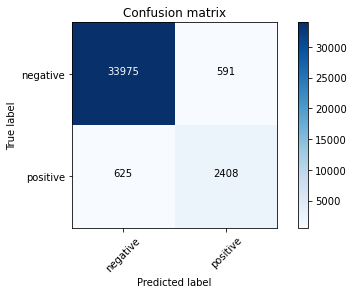

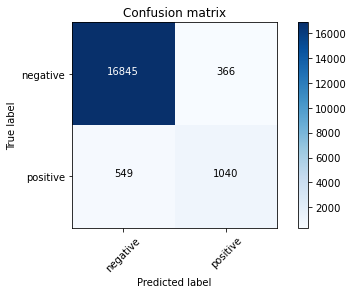

In [69]:
# Confusion Matrix
y_pred_test = model_m50.predict(test_dataset)
y_pred_train=model_m50.predict(dataset)
plot_confusion_matrix(confusion_matrix(y_train2, y_pred_train), ["negative", "positive"])
plt.show()
plot_confusion_matrix(confusion_matrix(y_test, y_pred_test), ["negative", "positive"])
plt.show()

We tried ensemble based stacking model with different number of base learners. From this what we observed is that after the model with 30 base learners, the auc score is not increasing significantly. Though the auc score increases, the mistakes in predicting churn is not decreasing.

Lets try this model using logistic regression as base learners as they this model has done a good job in predicting churn previously better than random forests and xgboost.

In [60]:
model_dt0 = pickle.load(open('model1_dt0', 'rb'))
model_dt1 = pickle.load(open('model1_dt1', 'rb'))
model_dt2 = pickle.load(open('model1_dt2', 'rb'))
model_dt3 = pickle.load(open('model1_dt3', 'rb'))
model_dt4 = pickle.load(open('model1_dt4', 'rb'))
model_dt5 = pickle.load(open('model1_dt5', 'rb'))
model_dt6 = pickle.load(open('model1_dt6', 'rb'))
model_dt7 = pickle.load(open('model1_dt7', 'rb'))
model_dt8 = pickle.load(open('model1_dt8', 'rb'))
model_dt9 = pickle.load(open('model1_dt9', 'rb'))
model_dt10 = pickle.load(open('model1_dt10', 'rb'))
model_dt11 = pickle.load(open('model1_dt11', 'rb'))
model_dt12 = pickle.load(open('model1_dt11', 'rb'))
model_dt13 = pickle.load(open('model1_dt11', 'rb'))
model_dt14 = pickle.load(open('model1_dt14', 'rb'))
model_dt15 = pickle.load(open('model1_dt15', 'rb'))
model_dt16 = pickle.load(open('model1_dt16', 'rb'))
model_dt17 = pickle.load(open('model1_dt17', 'rb'))
model_dt18 = pickle.load(open('model1_dt18', 'rb'))
model_dt19 = pickle.load(open('model1_dt19', 'rb'))
model_dt20 = pickle.load(open('model1_dt20', 'rb'))
model_dt21 = pickle.load(open('model1_dt21', 'rb'))
model_dt22 = pickle.load(open('model1_dt22', 'rb'))
model_dt23 = pickle.load(open('model1_dt23', 'rb'))
model_dt24 = pickle.load(open('model1_dt24', 'rb'))
model_dt25 = pickle.load(open('model1_dt25', 'rb'))
model_dt26 = pickle.load(open('model1_dt26', 'rb'))
model_dt27 = pickle.load(open('model1_dt27', 'rb'))
model_dt28 = pickle.load(open('model1_dt28', 'rb'))
model_dt29 = pickle.load(open('model1_dt29', 'rb'))
model_dt30 = pickle.load(open('model1_dt30', 'rb'))
model_dt31 = pickle.load(open('model1_dt31', 'rb'))
model_dt32 = pickle.load(open('model1_dt32', 'rb'))
model_dt33 = pickle.load(open('model1_dt33', 'rb'))
model_dt34 = pickle.load(open('model1_dt34', 'rb'))
model_dt35 = pickle.load(open('model1_dt35', 'rb'))
model_dt36 = pickle.load(open('model1_dt36', 'rb'))
model_dt37 = pickle.load(open('model1_dt37', 'rb'))
model_dt38 = pickle.load(open('model1_dt38', 'rb'))
model_dt39 = pickle.load(open('model1_dt39', 'rb'))
model_dt40 = pickle.load(open('model1_dt40', 'rb'))
model_dt41 = pickle.load(open('model1_dt41', 'rb'))
model_dt42 = pickle.load(open('model1_dt42', 'rb'))
model_dt43 = pickle.load(open('model1_dt43', 'rb'))
model_dt44 = pickle.load(open('model1_dt44', 'rb'))
model_dt45 = pickle.load(open('model1_dt45', 'rb'))
model_dt46 = pickle.load(open('model1_dt46', 'rb'))
model_dt47 = pickle.load(open('model1_dt47', 'rb'))
model_dt48 = pickle.load(open('model1_dt48', 'rb'))
model_dt49 = pickle.load(open('model1_dt49', 'rb'))


In [61]:
model=[model_dt0,model_dt1,model_dt2,model_dt3,model_dt4,model_dt5,model_dt6,model_dt7,model_dt8,model_dt9,model_dt10,
       model_dt11,model_dt12,model_dt13,model_dt14,model_dt15,model_dt16,model_dt17,model_dt18,model_dt19,model_dt20,
      model_dt21,model_dt22,model_dt23,model_dt24,model_dt25,model_dt26,model_dt27,model_dt28,model_dt29,
      model_dt30,model_dt31,model_dt32,model_dt33,model_dt34,model_dt35,model_dt36,model_dt37,model_dt38,model_dt39,
      model_dt40,model_dt41,model_dt42,model_dt43,model_dt44,model_dt45,model_dt46,model_dt47,model_dt48,model_dt49]

In [63]:
dataset=pd.DataFrame()
for i in range(len(model)):
    dataset['d'+str(i)]=model[i].predict(x_train2)

In [64]:
dataset.shape

(37599, 50)

In [67]:
model_mdl = Sequential()
model_mdl.add(Dense(12, input_dim=50, activation='relu'))
model_mdl.add(Dense(8, activation='relu'))
model_mdl.add(Dense(1, activation='sigmoid'))
# compile the keras model
model_mdl.compile(loss='binary_crossentropy', optimizer='adam', metrics=[tf.keras.metrics.AUC()])
# fit the keras model on the dataset
model_mdl.fit(dataset, y_train2, epochs=20, batch_size=10, verbose=1)
# evaluate the keras model
_, accuracy = model_mdl.evaluate(dataset, y_train2)
print('Train Accuracy: %.2f' % (accuracy*100))

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where

Epoch 1/20
37599/37599 [==============================] - 13s 340us/step - loss: 0.1609 - auc: 0.8557
Epoch 2/20
37599/37599 [==============================] - 12s 320us/step - loss: 0.1332 - auc: 0.9312
Epoch 3/20
37599/37599 [==============================] - 12s 323us/step - loss: 0.1316 - auc: 0.9392
Epoch 4/20
37599/37599 [==============================] - 12s 322us/step - loss: 0.1298 - auc: 0.9424
Epoch 5/20
37599/37599 [==============================] - 12s 319us/step - loss: 0.1284 - auc: 0.9446
Epoch 6/20
37599/37599 [==============================] - 12s 320us/step - loss: 0.1275 - auc: 0.9461
Epoch 7/20
37599/37599 [==============================] - 12s 324us/step - loss: 0.1268 - auc: 0.9473
Epoch 8/20
37599/37599 [==============================] - 12s 322us/step - loss: 0.1262 - auc: 0.9482
Epoch 9/

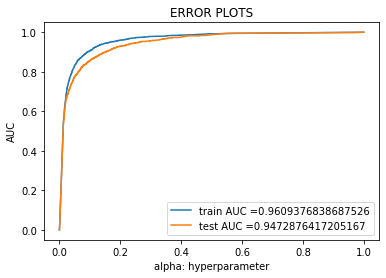

In [68]:
test_dataset=pd.DataFrame()
for i in range(len(model)):
    predict=model[i].predict(x_test)
    test_dataset['d'+str(i)]=predict

# Auc-error plots
y_train_proba=model_mdl.predict_proba(dataset)
#y_train_proba=y_train_proba[:,1]
y_test_proba=model_mdl.predict_proba(test_dataset)
#y_test_proba=y_test_proba[:,1]
train_fpr, train_tpr, thresholds = roc_curve(y_train2, y_train_proba)
test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_proba)

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("alpha: hyperparameter")
plt.ylabel("AUC")
plt.title("ERROR PLOTS")
plt.show()

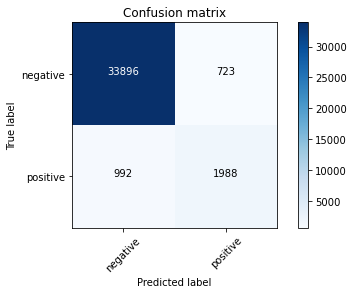

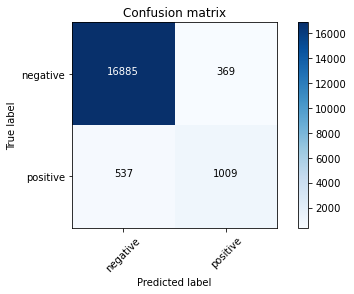

In [70]:
# Confusion Matrix
y_pred_test = model_mdl.predict(test_dataset).round()
y_pred_train=model_mdl.predict(dataset).round()
plot_confusion_matrix(confusion_matrix(y_train2, y_pred_train), ["negative", "positive"])
plt.show()
plot_confusion_matrix(confusion_matrix(y_test, y_pred_test), ["negative", "positive"])
plt.show()

In [71]:
model_mdl1 = Sequential()
model_mdl1.add(Dense(128, input_dim=50, activation='relu'))
model_mdl1.add(Dense(64, activation='relu'))
model_mdl1.add(Dense(32, activation='relu'))
model_mdl1.add(Dense(1, activation='sigmoid'))
# compile the keras model
model_mdl1.compile(loss='binary_crossentropy', optimizer='adam', metrics=[tf.keras.metrics.AUC()])
# fit the keras model on the dataset
model_mdl1.fit(dataset, y_train2, epochs=20, batch_size=10, verbose=1)
# evaluate the keras model
_, accuracy = model_mdl1.evaluate(dataset, y_train2)
print('Train Accuracy: %.2f' % (accuracy*100))

Epoch 1/20
37599/37599 [==============================] - 18s 469us/step - loss: 0.1438 - auc_1: 0.9210
Epoch 2/20
37599/37599 [==============================] - 16s 415us/step - loss: 0.1310 - auc_1: 0.9423
Epoch 3/20
37599/37599 [==============================] - 15s 411us/step - loss: 0.1277 - auc_1: 0.9465
Epoch 4/20
37599/37599 [==============================] - 15s 403us/step - loss: 0.1247 - auc_1: 0.9488
Epoch 5/20
37599/37599 [==============================] - 16s 424us/step - loss: 0.1226 - auc_1: 0.9508
Epoch 6/20
37599/37599 [==============================] - 17s 444us/step - loss: 0.1195 - auc_1: 0.9526
Epoch 7/20
37599/37599 [==============================] - 15s 407us/step - loss: 0.1168 - auc_1: 0.9541
Epoch 8/20
37599/37599 [==============================] - 16s 424us/step - loss: 0.1136 - auc_1: 0.9557
Epoch 9/20
37599/37599 [==============================] - 16s 438us/step - loss: 0.1107 - auc_1: 0.9572
Epoch 10/20
37599/37599 [==============================] - 15s 4

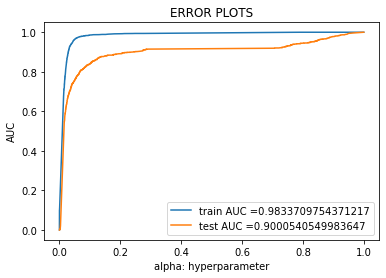

In [72]:
test_dataset=pd.DataFrame()
for i in range(len(model)):
    predict=model[i].predict(x_test)
    test_dataset['d'+str(i)]=predict

# Auc-error plots
y_train_proba=model_mdl1.predict_proba(dataset)
#y_train_proba=y_train_proba[:,1]
y_test_proba=model_mdl1.predict_proba(test_dataset)
#y_test_proba=y_test_proba[:,1]
train_fpr, train_tpr, thresholds = roc_curve(y_train2, y_train_proba)
test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_proba)

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("alpha: hyperparameter")
plt.ylabel("AUC")
plt.title("ERROR PLOTS")
plt.show()

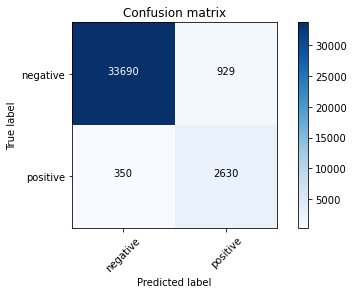

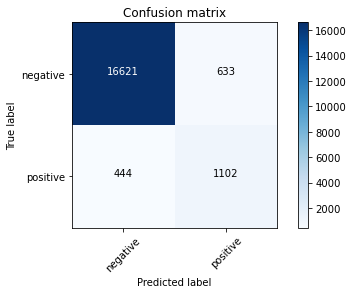

In [73]:
# Confusion Matrix
y_pred_test = model_mdl1.predict(test_dataset).round()
y_pred_train=model_mdl1.predict(dataset).round()
plot_confusion_matrix(confusion_matrix(y_train2, y_pred_train), ["negative", "positive"])
plt.show()
plot_confusion_matrix(confusion_matrix(y_test, y_pred_test), ["negative", "positive"])
plt.show()

## Ensemble based stacking models with logistic regression as base learners

In [56]:
def lr(data,labels):
    # Hyperparameter tuning
    c_val=[10**-4, 10**-2, 10**0, 10**2, 10**4]
    #solvers = ['newton-cg', 'lbfgs', 'liblinear']
    tuned_parameters = {'C': c_val}

    model_lr_m = GridSearchCV(LogisticRegression(penalty='l2',class_weight='balanced'), tuned_parameters, scoring = 'roc_auc', cv=5)
    model_lr_m.fit(data, labels)

    #print(model_lr_m.best_estimator_)
    print(model_lr_m.score(data, labels))
    return model_lr_m.predict(x_train2)


In [64]:
def xgboostlr(data):
    # Hyperparameter tuning
    depth = [5,20,50,100,150,200]
    base_learners = [100, 200, 300, 400, 500]
    param_grid = {'max_depth':depth,'n_estimators':base_learners}
    #Using GridSearchCV #model = GridSearchCV(SGDClassifier(loss='hinge'), param_grid, scoring = 'f1_micro', cv=3 ,
    model_gb_lm1 = GridSearchCV(XGBClassifier(), param_grid, scoring = 'f1',cv=5)
    model_gb_lm1.fit(data, y_train2)
    print(model_gb_lm1.best_estimator_)
    print("Train xgboost AUC score",model_gb_lm1.score(data, y_train2))
    filename = 'model1_lm'+str(data.shape[1])
    pickle.dump(model_gb_lm1, open(filename, 'wb'))

In [65]:
dataset_lr=pd.DataFrame()
def ensemble_lr(num):
    for i in range(num):
        t=df.sample(n=35000,replace=True)
        labels=t['churn']
        data=t.drop(columns='churn')
        
        predict=lr(data,labels)
        dataset_lr['d'+str(i)]=predict
    xgboostlr(dataset_lr)

In [66]:
ensemble_lr(7)

0.8914667333281842
0.8805749926463472
0.8807096639949958
0.8665905931187807
0.8871073343467537
0.8795156094699381
0.880769287200684
XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=5,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=500, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)
Train xgboost AUC score 0.0032873109796186717


In [84]:
dataset_lr.shape

(37599, 7)

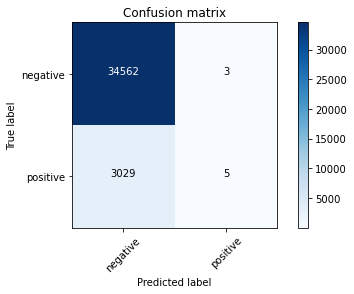

In [67]:
model_lm7 = pickle.load(open('model1_lm7', 'rb'))
y_pred_train=model_lm7.predict(dataset_lr)

plot_confusion_matrix(confusion_matrix(y_train2, y_pred_train), ["negative", "positive"])
plt.show()

Even after hypertuning the model, this model is  still overfitting

In [86]:
model_ldl1 = Sequential()
model_ldl1.add(Dense(128, input_dim=7, activation='relu'))
model_ldl1.add(Dense(64, activation='relu'))
model_ldl1.add(Dense(32, activation='relu'))
model_ldl1.add(Dense(1, activation='sigmoid'))
# compile the keras model
model_ldl1.compile(loss='binary_crossentropy', optimizer='adam', metrics=[tf.keras.metrics.AUC()])
# fit the keras model on the dataset
model_ldl1.fit(dataset_lr, y_train2, epochs=20, batch_size=10, verbose=1)
# evaluate the keras model
_, accuracy = model_ldl1.evaluate(dataset_lr, y_train2)
print('Train Accuracy: %.2f' % (accuracy*100))

Epoch 1/20
37599/37599 [==============================] - 17s 461us/step - loss: 0.2022 - auc_3: 0.8146
Epoch 2/20
37599/37599 [==============================] - 16s 421us/step - loss: 0.1955 - auc_3: 0.8511
Epoch 3/20
37599/37599 [==============================] - 16s 418us/step - loss: 0.1948 - auc_3: 0.8517
Epoch 4/20
37599/37599 [==============================] - 16s 429us/step - loss: 0.1942 - auc_3: 0.8533
Epoch 5/20
37599/37599 [==============================] - 16s 427us/step - loss: 0.1942 - auc_3: 0.8540
Epoch 6/20
37599/37599 [==============================] - 16s 422us/step - loss: 0.1938 - auc_3: 0.8551
Epoch 7/20
37599/37599 [==============================] - 16s 431us/step - loss: 0.1937 - auc_3: 0.8555
Epoch 8/20
37599/37599 [==============================] - 16s 415us/step - loss: 0.1938 - auc_3: 0.8559
Epoch 9/20
37599/37599 [==============================] - 16s 424us/step - loss: 0.1935 - auc_3: 0.8556
Epoch 10/20
37599/37599 [==============================] - 16s 4

## Deep learning models

In [51]:
import tensorflow as tf
from keras.utils import np_utils 
from keras.initializers import RandomNormal
from keras.models import Sequential 
from keras.layers import Dense, Activation 
from keras.initializers import he_normal

Using TensorFlow backend.


In [52]:
X_train.shape

(60159, 126)

In [ ]:
model2_dl = Sequential()
model2_dl.add(Dense(12, input_dim=126, activation='relu'))
model2_dl.add(Dense(8, activation='relu'))
model2_dl.add(Dense(1, activation='sigmoid'))
# compile the keras model
model2_dl.compile(loss='binary_crossentropy', optimizer='adam', metrics=[tf.keras.metrics.AUC()])
# fit the keras model on the dataset
model2_dl.fit(X_train, y_train, epochs=20, batch_size=10)
# evaluate the keras model
_, accuracy = model2_dl.evaluate(X_cv, y_cv)
print('Accuracy: %.2f' % (accuracy*100))

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where

Epoch 1/20
60159/60159 [==============================] - 20s 336us/step - loss: 0.1991 - auc: 0.8244
Epoch 2/20
60159/60159 [==============================] - 19s 316us/step - loss: 0.1718 - auc: 0.8845
Epoch 3/20
60159/60159 [==============================] - 19s 324us/step - loss: 0.1644 - auc: 0.8963
Epoch 4/20
60159/60159 [==============================] - 19s 323us/step - loss: 0.1613 - auc: 0.9021
Epoch 5/20
60159/60159 [==============================] - 20s 339us/step - loss: 0.1589 - auc: 0.9061
Epoch 6/20
60159/60159 [==============================] - 20s 326us/step - loss: 0.1578 - auc: 0.9093
Epoch 7/20
60159/60159 [==============================] - 21s 344us/step - loss: 0.1557 - auc: 0.9118
Epoch 8/20
60159/60159 [==============================] - 19s 323us/step - loss: 0.1554 - auc: 0.9139
Epoch 9/

In [57]:
model_dl = Sequential()
model_dl.add(Dense(12, input_dim=126, activation='relu'))
model_dl.add(Dense(8, activation='relu'))
model_dl.add(Dense(1, activation='sigmoid'))
# compile the keras model
model_dl.compile(loss='binary_crossentropy', optimizer='adam', metrics=[tf.keras.metrics.AUC()])
# fit the keras model on the dataset
model_dl.fit(X_train, y_train, epochs=20, batch_size=10)
# evaluate the keras model
_, accuracy = model_dl.evaluate(X_cv, y_cv)
print('Accuracy: %.2f' % (accuracy*100))

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where

Epoch 1/20
60159/60159 [==============================] - 35s 582us/step - loss: 0.2013 - auc: 0.8077
Epoch 2/20
60159/60159 [==============================] - 36s 598us/step - loss: 0.1694 - auc: 0.8777
Epoch 3/20
60159/60159 [==============================] - 34s 572us/step - loss: 0.1628 - auc: 0.8916
Epoch 4/20
60159/60159 [==============================] - 36s 606us/step - loss: 0.1589 - auc: 0.8986
Epoch 5/20
60159/60159 [==============================] - 36s 596us/step - loss: 0.1567 - auc: 0.9038
Epoch 6/20
60159/60159 [==============================] - 38s 636us/step - loss: 0.1546 - auc: 0.9070
Epoch 7/20
60159/60159 [==============================] - 36s 591us/step - loss: 0.1538 - auc: 0.9097
Epoch 8/20
60159/60159 [==============================] - 43s 707us/step - loss: 0.1529 - auc: 0.9118
Epoch 9/

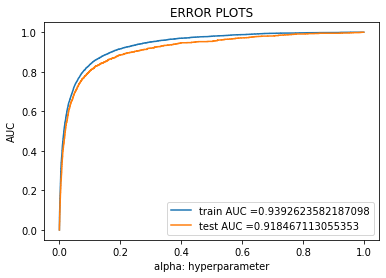

In [58]:
y_train_proba=model_dl.predict_proba(X_train)
#y_train_proba=y_train_proba[:,1]
y_test_proba=model_dl.predict_proba(X_test)
#y_test_proba=y_test_proba[:,1]
train_fpr, train_tpr, thresholds = roc_curve(y_train, y_train_proba)
test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_proba)

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("alpha: hyperparameter")
plt.ylabel("AUC")
plt.title("ERROR PLOTS")
plt.show()

In [53]:
model2_dl1 = Sequential()
model2_dl1.add(Dense(128, input_dim=126, activation='relu'))
model2_dl1.add(Dense(64, activation='relu'))
model2_dl1.add(Dense(32, activation='relu'))
model2_dl1.add(Dense(1, activation='sigmoid'))
# compile the keras model
model2_dl1.compile(loss='binary_crossentropy', optimizer='adam', metrics=[tf.keras.metrics.AUC()])
# fit the keras model on the dataset
model2_dl1.fit(X_train, y_train, epochs=20, batch_size=10,verbose=1, validation_data=(X_cv, y_cv))
# evaluate the keras model
_, accuracy = model2_dl1.evaluate(X_cv, y_cv)
print('Accuracy: %.2f' % (accuracy*100))

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where

Train on 60159 samples, validate on 15040 samples
Epoch 1/20
60159/60159 [==============================] - 29s 487us/step - loss: 0.1910 - auc: 0.8426 - val_loss: 0.1828 - val_auc: 0.8833
Epoch 2/20
60159/60159 [==============================] - 31s 515us/step - loss: 0.1665 - auc: 0.8917 - val_loss: 0.1784 - val_auc: 0.8965
Epoch 3/20
60159/60159 [==============================] - 28s 462us/step - loss: 0.1599 - auc: 0.8993 - val_loss: 0.1759 - val_auc: 0.9030
Epoch 4/20
60159/60159 [==============================] - 27s 454us/step - loss: 0.1557 - auc: 0.9058 - val_loss: 0.1717 - val_auc: 0.9077
Epoch 5/20
60159/60159 [==============================] - 28s 462us/step - loss: 0.1523 - auc: 0.9097 - val_loss: 0.1691 - val_auc: 0.9112
Epoch 6/20
60159/60159 [==============================] - 26s 432us/step - loss

In [60]:
model1_dl1 = Sequential()
model1_dl1.add(Dense(128, input_dim=126, activation='relu'))
model1_dl1.add(Dense(64, activation='relu'))
model1_dl1.add(Dense(32, activation='relu'))
model1_dl1.add(Dense(1, activation='sigmoid'))
# compile the keras model
model1_dl1.compile(loss='binary_crossentropy', optimizer='adam', metrics=[tf.keras.metrics.AUC()])
# fit the keras model on the dataset
model1_dl1.fit(X_train, y_train, epochs=20, batch_size=10,verbose=1, validation_data=(X_cv, y_cv))
# evaluate the keras model
_, accuracy = model1_dl1.evaluate(X_cv, y_cv)
print('Accuracy: %.2f' % (accuracy*100))

Train on 60159 samples, validate on 15040 samples
Epoch 1/20
60159/60159 [==============================] - 58s 966us/step - loss: 0.1883 - auc_1: 0.8528 - val_loss: 0.1785 - val_auc_1: 0.8820
Epoch 2/20
60159/60159 [==============================] - 59s 975us/step - loss: 0.1670 - auc_1: 0.8902 - val_loss: 0.1705 - val_auc_1: 0.8960
Epoch 3/20
60159/60159 [==============================] - 51s 853us/step - loss: 0.1609 - auc_1: 0.9005 - val_loss: 0.1698 - val_auc_1: 0.9030
Epoch 4/20
60159/60159 [==============================] - 49s 814us/step - loss: 0.1566 - auc_1: 0.9059 - val_loss: 0.1753 - val_auc_1: 0.9072
Epoch 5/20
60159/60159 [==============================] - 57s 950us/step - loss: 0.1523 - auc_1: 0.9091 - val_loss: 0.1872 - val_auc_1: 0.9099
Epoch 6/20
60159/60159 [==============================] - 50s 829us/step - loss: 0.1493 - auc_1: 0.9113 - val_loss: 0.1781 - val_auc_1: 0.9124
Epoch 7/20
60159/60159 [==============================] - 54s 893us/step - loss: 0.1458 - au

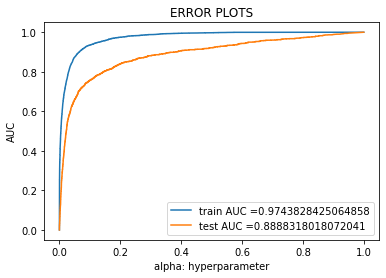

In [54]:
y_train_proba=model2_dl1.predict_proba(X_train)
#y_train_proba=y_train_proba[:,1]
y_test_proba=model2_dl1.predict_proba(X_test)
#y_test_proba=y_test_proba[:,1]
train_fpr, train_tpr, thresholds = roc_curve(y_train, y_train_proba)
test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_proba)

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("alpha: hyperparameter")
plt.ylabel("AUC")
plt.title("ERROR PLOTS")
plt.show()

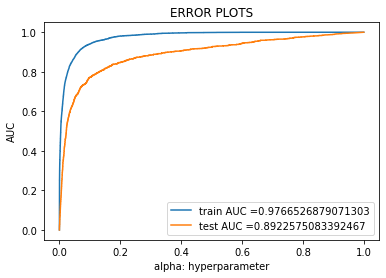

In [61]:
y_train_proba=model1_dl1.predict_proba(X_train)
#y_train_proba=y_train_proba[:,1]
y_test_proba=model1_dl1.predict_proba(X_test)
#y_test_proba=y_test_proba[:,1]
train_fpr, train_tpr, thresholds = roc_curve(y_train, y_train_proba)
test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_proba)

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("alpha: hyperparameter")
plt.ylabel("AUC")
plt.title("ERROR PLOTS")
plt.show()

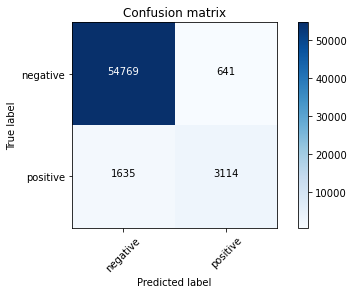

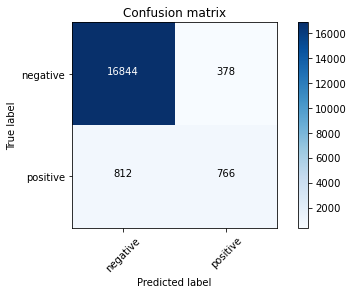

In [62]:
# Confusion Matrix
y_pred_test = model1_dl1.predict(X_test)
y_pred_test=y_pred_test.round()
y_pred_train=model1_dl1.predict(X_train)
y_pred_train=y_pred_train.round()
plot_confusion_matrix(confusion_matrix(y_train, y_pred_train), ["negative", "positive"])
plt.show()
plot_confusion_matrix(confusion_matrix(y_test, y_pred_test), ["negative", "positive"])
plt.show()

In [54]:
model_dl1 = Sequential()
model_dl1.add(Dense(128, input_dim=126, activation='relu'))
model_dl1.add(Dense(64, activation='relu'))
model_dl1.add(Dense(32, activation='relu'))
model_dl1.add(Dense(1, activation='sigmoid'))
# compile the keras model
model_dl1.compile(loss='binary_crossentropy', optimizer='adam', metrics=[tf.keras.metrics.AUC()])
# fit the keras model on the dataset
model_dl1.fit(X_train, y_train, epochs=20, batch_size=10,verbose=1, validation_data=(X_cv, y_cv))
# evaluate the keras model
_, accuracy = model_dl1.evaluate(X_cv, y_cv)
print('Accuracy: %.2f' % (accuracy*100))


Train on 60159 samples, validate on 15040 samples
Epoch 1/20
60159/60159 [==============================] - 31s 519us/step - loss: 0.1907 - auc: 0.8485 - val_loss: 0.1764 - val_auc: 0.8822
Epoch 2/20
60159/60159 [==============================] - 30s 498us/step - loss: 0.1703 - auc: 0.8905 - val_loss: 0.1632 - val_auc: 0.8950
Epoch 3/20
60159/60159 [==============================] - 30s 497us/step - loss: 0.1633 - auc: 0.8995 - val_loss: 0.1607 - val_auc: 0.9023
Epoch 4/20
60159/60159 [==============================] - 30s 501us/step - loss: 0.1594 - auc: 0.9050 - val_loss: 0.1604 - val_auc: 0.9067
Epoch 5/20
60159/60159 [==============================] - 30s 496us/step - loss: 0.1560 - auc: 0.9089 - val_loss: 0.1563 - val_auc: 0.9103
Epoch 6/20
60159/60159 [==============================] - 30s 494us/step - loss: 0.1526 - auc: 0.9121 - val_loss: 0.1594 - val_auc: 0.9133
Epoch 7/20
60159/60159 [==============================] - 30s 502us/step - loss: 0.1493 - auc: 0.9146 - val_loss: 0

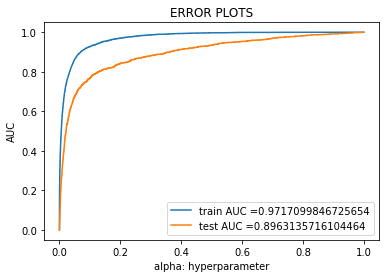

In [55]:
y_train_proba=model_dl1.predict_proba(X_train)
#y_train_proba=y_train_proba[:,1]
y_test_proba=model_dl1.predict_proba(X_test)
#y_test_proba=y_test_proba[:,1]
train_fpr, train_tpr, thresholds = roc_curve(y_train, y_train_proba)
test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_proba)

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("alpha: hyperparameter")
plt.ylabel("AUC")
plt.title("ERROR PLOTS")
plt.show()

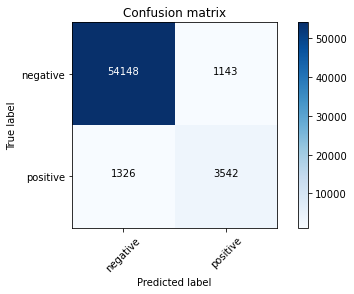

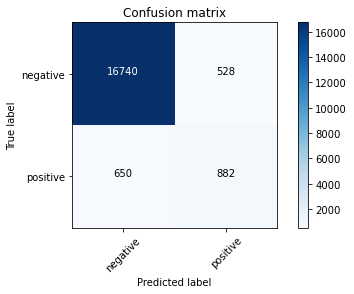

In [56]:
# Confusion Matrix
y_pred_test = model_dl1.predict(X_test)
y_pred_test=y_pred_test.round()
y_pred_train=model_dl1.predict(X_train)
y_pred_train=y_pred_train.round()
plot_confusion_matrix(confusion_matrix(y_train, y_pred_train), ["negative", "positive"])
plt.show()
plot_confusion_matrix(confusion_matrix(y_test, y_pred_test), ["negative", "positive"])
plt.show()

In [63]:
model1_dl2 = Sequential()
model1_dl2.add(Dense(64, input_dim=126, activation='relu'))
model1_dl2.add(Dense(32, activation='relu'))
model1_dl2.add(Dense(1, activation='sigmoid'))
# compile the keras model
model1_dl2.compile(loss='binary_crossentropy', optimizer='adam', metrics=[tf.keras.metrics.AUC()])
# fit the keras model on the dataset
model1_dl2.fit(X_train, y_train, epochs=10, batch_size=10,verbose=1, validation_data=(X_cv, y_cv))
# evaluate the keras model
_, accuracy = model1_dl2.evaluate(X_cv, y_cv)
print('Accuracy: %.2f' % (accuracy*100))

Train on 60159 samples, validate on 15040 samples
Epoch 1/10
60159/60159 [==============================] - 54s 894us/step - loss: 0.1886 - auc_2: 0.8476 - val_loss: 0.1757 - val_auc_2: 0.8827
Epoch 2/10
60159/60159 [==============================] - 52s 869us/step - loss: 0.1673 - auc_2: 0.8917 - val_loss: 0.1715 - val_auc_2: 0.8959
Epoch 3/10
60159/60159 [==============================] - 50s 832us/step - loss: 0.1589 - auc_2: 0.9007 - val_loss: 0.1709 - val_auc_2: 0.9037
Epoch 4/10
60159/60159 [==============================] - 54s 895us/step - loss: 0.1549 - auc_2: 0.9066 - val_loss: 0.1702 - val_auc_2: 0.9084
Epoch 5/10
60159/60159 [==============================] - 51s 848us/step - loss: 0.1513 - auc_2: 0.9108 - val_loss: 0.1669 - val_auc_2: 0.9120
Epoch 6/10
60159/60159 [==============================] - 48s 797us/step - loss: 0.1476 - auc_2: 0.9137 - val_loss: 0.1682 - val_auc_2: 0.9149
Epoch 7/10
60159/60159 [==============================] - 56s 923us/step - loss: 0.1455 - au

In [57]:
model_dl2 = Sequential()
model_dl2.add(Dense(64, input_dim=126, activation='relu'))
model_dl2.add(Dense(32, activation='relu'))
model_dl2.add(Dense(1, activation='sigmoid'))
# compile the keras model
model_dl2.compile(loss='binary_crossentropy', optimizer='adam', metrics=[tf.keras.metrics.AUC()])
# fit the keras model on the dataset
model_dl2.fit(X_train, y_train, epochs=20, batch_size=10,verbose=1, validation_data=(X_cv, y_cv))
# evaluate the keras model
_, accuracy = model_dl2.evaluate(X_cv, y_cv)
print('Accuracy: %.2f' % (accuracy*100))

Train on 60159 samples, validate on 15040 samples
Epoch 1/10
60159/60159 [==============================] - 26s 440us/step - loss: 0.1924 - auc_1: 0.8506 - val_loss: 0.1727 - val_auc_1: 0.8816
Epoch 2/10
60159/60159 [==============================] - 26s 425us/step - loss: 0.1702 - auc_1: 0.8913 - val_loss: 0.1650 - val_auc_1: 0.8955
Epoch 3/10
60159/60159 [==============================] - 25s 412us/step - loss: 0.1632 - auc_1: 0.8997 - val_loss: 0.1626 - val_auc_1: 0.9025
Epoch 4/10
60159/60159 [==============================] - 26s 424us/step - loss: 0.1580 - auc_1: 0.9057 - val_loss: 0.1601 - val_auc_1: 0.9074
Epoch 5/10
60159/60159 [==============================] - 26s 437us/step - loss: 0.1547 - auc_1: 0.9097 - val_loss: 0.1580 - val_auc_1: 0.9111
Epoch 6/10
60159/60159 [==============================] - 27s 450us/step - loss: 0.1515 - auc_1: 0.9130 - val_loss: 0.1686 - val_auc_1: 0.9139
Epoch 7/10
60159/60159 [==============================] - 26s 429us/step - loss: 0.1491 - au

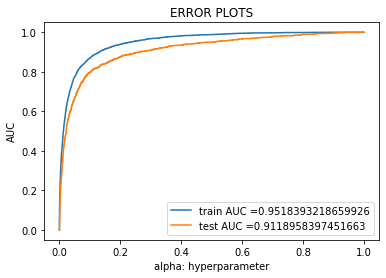

In [64]:
y_train_proba=model1_dl2.predict_proba(X_train)
#y_train_proba=y_train_proba[:,1]
y_test_proba=model1_dl2.predict_proba(X_test)
#y_test_proba=y_test_proba[:,1]
train_fpr, train_tpr, thresholds = roc_curve(y_train, y_train_proba)
test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_proba)

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("alpha: hyperparameter")
plt.ylabel("AUC")
plt.title("ERROR PLOTS")
plt.show()

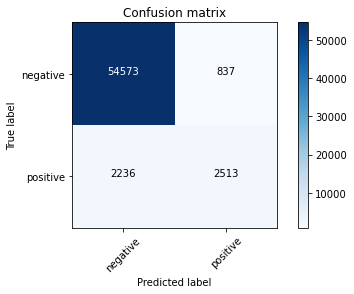

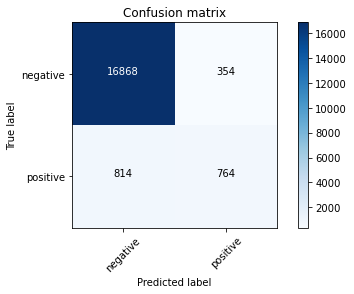

In [65]:
# Confusion Matrix
y_pred_test = model1_dl2.predict(X_test)
y_pred_test=y_pred_test.round()
y_pred_train=model1_dl2.predict(X_train)
y_pred_train=y_pred_train.round()
plot_confusion_matrix(confusion_matrix(y_train, y_pred_train), ["negative", "positive"])
plt.show()
plot_confusion_matrix(confusion_matrix(y_test, y_pred_test), ["negative", "positive"])
plt.show()

In [66]:
model1_dl3 = Sequential()
model1_dl3.add(Dense(32, input_dim=126, activation='relu'))
model1_dl3.add(Dense(16, activation='relu'))
model1_dl3.add(Dense(1, activation='sigmoid'))
# compile the keras model
model1_dl3.compile(loss='binary_crossentropy', optimizer='adam', metrics=[tf.keras.metrics.AUC()])
# fit the keras model on the dataset
model1_dl3.fit(X_train, y_train, epochs=20, batch_size=10,verbose=1, validation_data=(X_cv, y_cv))
# evaluate the keras model
_, accuracy = model1_dl3.evaluate(X_cv, y_cv)
print('Accuracy: %.2f' % (accuracy*100))

Train on 60159 samples, validate on 15040 samples
Epoch 1/20
60159/60159 [==============================] - 46s 768us/step - loss: 0.1894 - auc_3: 0.8359 - val_loss: 0.1787 - val_auc_3: 0.8803
Epoch 2/20
60159/60159 [==============================] - 44s 735us/step - loss: 0.1655 - auc_3: 0.8898 - val_loss: 0.1740 - val_auc_3: 0.8954
Epoch 3/20
60159/60159 [==============================] - 45s 743us/step - loss: 0.1589 - auc_3: 0.8998 - val_loss: 0.1659 - val_auc_3: 0.9030
Epoch 4/20
60159/60159 [==============================] - 43s 722us/step - loss: 0.1553 - auc_3: 0.9058 - val_loss: 0.1662 - val_auc_3: 0.9077
Epoch 5/20
60159/60159 [==============================] - 45s 752us/step - loss: 0.1519 - auc_3: 0.9097 - val_loss: 0.1659 - val_auc_3: 0.9112
Epoch 6/20
60159/60159 [==============================] - 47s 774us/step - loss: 0.1497 - auc_3: 0.9125 - val_loss: 0.1660 - val_auc_3: 0.9137
Epoch 7/20
60159/60159 [==============================] - 43s 720us/step - loss: 0.1477 - au

In [58]:
model_dl3 = Sequential()
model_dl3.add(Dense(32, input_dim=126, activation='relu'))
model_dl3.add(Dense(16, activation='relu'))
model_dl3.add(Dense(1, activation='sigmoid'))
# compile the keras model
model_dl3.compile(loss='binary_crossentropy', optimizer='adam', metrics=[tf.keras.metrics.AUC()])
# fit the keras model on the dataset
model_dl3.fit(X_train, y_train, epochs=20, batch_size=10,verbose=1, validation_data=(X_cv, y_cv))
# evaluate the keras model
_, accuracy = model_dl3.evaluate(X_cv, y_cv)
print('Accuracy: %.2f' % (accuracy*100))

Train on 60159 samples, validate on 15040 samples
Epoch 1/20
60159/60159 [==============================] - 27s 443us/step - loss: 0.1943 - auc_2: 0.8335 - val_loss: 0.1709 - val_auc_2: 0.8777
Epoch 2/20
60159/60159 [==============================] - 25s 408us/step - loss: 0.1699 - auc_2: 0.8890 - val_loss: 0.1730 - val_auc_2: 0.8936
Epoch 3/20
60159/60159 [==============================] - 25s 411us/step - loss: 0.1631 - auc_2: 0.8981 - val_loss: 0.1618 - val_auc_2: 0.9008
Epoch 4/20
60159/60159 [==============================] - 26s 429us/step - loss: 0.1588 - auc_2: 0.9040 - val_loss: 0.1617 - val_auc_2: 0.9057
Epoch 5/20
60159/60159 [==============================] - 25s 415us/step - loss: 0.1565 - auc_2: 0.9079 - val_loss: 0.1598 - val_auc_2: 0.9092
Epoch 6/20
60159/60159 [==============================] - 25s 420us/step - loss: 0.1540 - auc_2: 0.9109 - val_loss: 0.1573 - val_auc_2: 0.9120
Epoch 7/20
60159/60159 [==============================] - 27s 441us/step - loss: 0.1515 - au

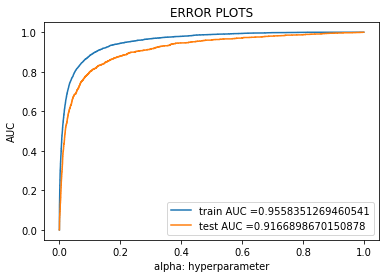

In [67]:
y_train_proba=model1_dl3.predict_proba(X_train)
#y_train_proba=y_train_proba[:,1]
y_test_proba=model1_dl3.predict_proba(X_test)
#y_test_proba=y_test_proba[:,1]
train_fpr, train_tpr, thresholds = roc_curve(y_train, y_train_proba)
test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_proba)

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("alpha: hyperparameter")
plt.ylabel("AUC")
plt.title("ERROR PLOTS")
plt.show()

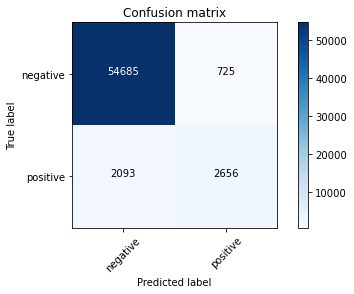

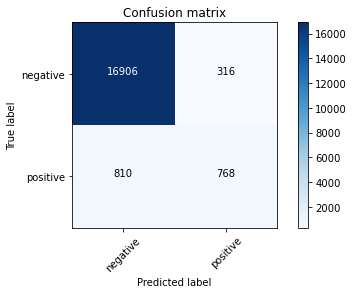

In [68]:
# Confusion Matrix
y_pred_test = model1_dl3.predict(X_test)
y_pred_test=y_pred_test.round()
y_pred_train=model1_dl3.predict(X_train)
y_pred_train=y_pred_train.round()
plot_confusion_matrix(confusion_matrix(y_train, y_pred_train), ["negative", "positive"])
plt.show()
plot_confusion_matrix(confusion_matrix(y_test, y_pred_test), ["negative", "positive"])
plt.show()

In [69]:
model1_dl4 = Sequential()
model1_dl4.add(Dense(128, input_dim=126, activation='relu'))
model1_dl4.add(Dense(64, activation='relu'))
model1_dl4.add(Dense(1, activation='sigmoid'))
# compile the keras model
model1_dl4.compile(loss='binary_crossentropy', optimizer='adam', metrics=[tf.keras.metrics.AUC()])
# fit the keras model on the dataset
model1_dl4.fit(X_train, y_train, epochs=30, batch_size=10, verbose=1, validation_data=(X_cv, y_cv))
# evaluate the keras model
_, accuracy = model1_dl4.evaluate(X_cv, y_cv)
print('Accuracy: %.2f' % (accuracy*100))

Train on 60159 samples, validate on 15040 samples
Epoch 1/30
60159/60159 [==============================] - 58s 966us/step - loss: 0.1867 - auc_4: 0.8608 - val_loss: 0.1755 - val_auc_4: 0.8856
Epoch 2/30
60159/60159 [==============================] - 57s 946us/step - loss: 0.1663 - auc_4: 0.8941 - val_loss: 0.1747 - val_auc_4: 0.8982
Epoch 3/30
60159/60159 [==============================] - 50s 832us/step - loss: 0.1592 - auc_4: 0.9025 - val_loss: 0.1666 - val_auc_4: 0.9048
Epoch 4/30
60159/60159 [==============================] - 51s 851us/step - loss: 0.1547 - auc_4: 0.9077 - val_loss: 0.1798 - val_auc_4: 0.9091
Epoch 5/30
60159/60159 [==============================] - 53s 873us/step - loss: 0.1512 - auc_4: 0.9107 - val_loss: 0.1681 - val_auc_4: 0.9121
Epoch 6/30
60159/60159 [==============================] - 53s 877us/step - loss: 0.1472 - auc_4: 0.9137 - val_loss: 0.1709 - val_auc_4: 0.9150
Epoch 7/30
60159/60159 [==============================] - 55s 909us/step - loss: 0.1444 - au

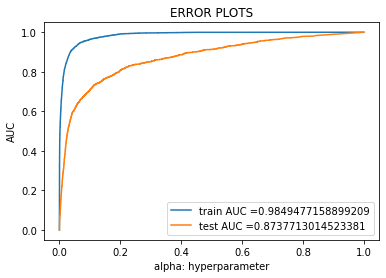

In [70]:
y_train_proba=model1_dl4.predict_proba(X_train)
#y_train_proba=y_train_proba[:,1]
y_test_proba=model1_dl4.predict_proba(X_test)
#y_test_proba=y_test_proba[:,1]
train_fpr, train_tpr, thresholds = roc_curve(y_train, y_train_proba)
test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_proba)

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("alpha: hyperparameter")
plt.ylabel("AUC")
plt.title("ERROR PLOTS")
plt.show()

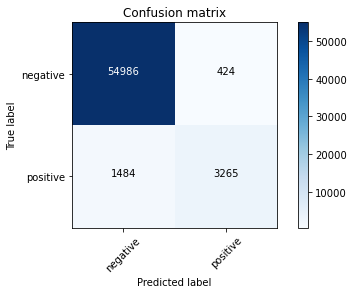

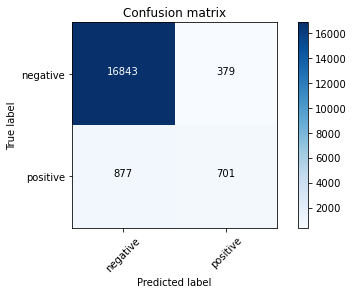

In [71]:
# Confusion Matrix
y_pred_test = model1_dl4.predict(X_test)
y_pred_test=y_pred_test.round()
y_pred_train=model1_dl4.predict(X_train)
y_pred_train=y_pred_train.round()
plot_confusion_matrix(confusion_matrix(y_train, y_pred_train), ["negative", "positive"])
plt.show()
plot_confusion_matrix(confusion_matrix(y_test, y_pred_test), ["negative", "positive"])
plt.show()

In [66]:
from prettytable import PrettyTable 
x = PrettyTable() 
x.field_names=['Model','Auc'] 
x.add_row(['Decision Tree',0.9])
x.add_row(['Logistic Regression',0.89])
x.add_row(['Random forests',0.933])
x.add_row(['Xgboost',0.932]) 
x.add_row(['Logistic regression (SMOTE)',0.88])
x.add_row(['PCA + Logistic regression',0.896]) 
x.add_row(['decison tree(40) + xgboost',0.942]) 
x.add_row(['decison tree(50) + xgboost',0.945]) 
x.add_row(['MLP',0.91]) 

print(x)


+-----------------------------+-------+
|            Model            |  Auc  |
+-----------------------------+-------+
|        Decision Tree        |  0.9  |
|     Logistic Regression     |  0.89 |
|        Random forests       | 0.933 |
|           Xgboost           | 0.932 |
| Logistic regression (SMOTE) |  0.88 |
|  PCA + Logistic regression  | 0.896 |
|  decison tree(40) + xgboost | 0.942 |
|  decison tree(50) + xgboost | 0.945 |
|             MLP             |  0.91 |
+-----------------------------+-------+
